In [2]:
#import the library
import scanpy as sc
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb
import seaborn as sns
import logging
import os

import importlib
import warnings
warnings.filterwarnings("ignore")

import pickle as pkl
from matplotlib.colors import LinearSegmentedColormap

In [3]:
def print_full(x):
    pd.set_option('display.max_rows', len(x))
    print(x)
    pd.reset_option('display.max_rows')

In [4]:
#This pallete is for colorblinds
my_palette = ['#0351A8','#8CB0E0','#D56D11','#FFBB78','#234E08','#53CB8B','#D30083','#CB788D','#4E195A','#C58CCF','#AA290F','#B03FD1','#E8BCCF','#64605F','#B2AD9A','#D2D30B','#D1BD4F','#06DCF2','#9EDAE5','#517219','#5B43CF','#D92F24','#FFD900','#002F33','#B8A3A3']

In [5]:
from matplotlib.colors import LinearSegmentedColormap
values = [0, 1]
colors = [(227, 227, 227), (255, 42, 18)]
colors = [tuple(np.array(color) / 255) for color in colors]
my_cmap = LinearSegmentedColormap.from_list('', colors)

In [106]:
# Ignore R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

# Automatically convert rpy2 outputs to pandas dataframes
pandas2ri.activate()
anndata2ri.activate()
%load_ext rpy2.ipython

In [11]:
plt.rcParams['figure.figsize']=(8,8) #rescale figures
sc.settings.verbosity = 3
#sc.set_figure_params(dpi=200, dpi_save=300)
sc.logging.print_versions()

-----
anndata     0.10.7
scanpy      1.10.1
-----
PIL                         10.2.0
anyio                       NA
asttokens                   NA
attr                        23.1.0
attrs                       23.1.0
babel                       2.11.0
beta_ufunc                  NA
binom_ufunc                 NA
bottleneck                  1.3.7
brotli                      1.0.9
certifi                     2024.07.04
cffi                        1.16.0
chardet                     4.0.0
charset_normalizer          2.0.4
cloudpickle                 2.2.1
colorama                    0.4.6
comm                        0.1.2
cycler                      0.10.0
cython_runtime              NA
cytoolz                     0.12.2
dask                        2023.11.0
dateutil                    2.8.2
debugpy                     1.6.7
decorator                   5.1.1
defusedxml                  0.7.1
entrypoints                 0.4
executing                   0.8.3
fastjsonschema              NA
h5

In [108]:
%%R
.libPaths(.libPaths('C:\\Users\\16220\\AppData\\Local\\R\\win-library\\4.3'))

In [109]:
%%R
library(scran)
library(Seurat)
library(RColorBrewer)
library(slingshot)
library(monocle)
library(gam)
library(ggplot2)
library(plyr)
library(MAST)
library(clusterExperiment)
library(monocle3)

Exception ignored from cffi callback <function _consolewrite_ex at 0x0000029F2C8661F0>:
Traceback (most recent call last):
  File "C:\Users\16220\anaconda3\envs\cpdb\lib\site-packages\rpy2\rinterface_lib\callbacks.py", line 133, in _consolewrite_ex
    s = conversion._cchar_to_str_with_maxlen(buf, n, _CCHAR_ENCODING)
  File "C:\Users\16220\anaconda3\envs\cpdb\lib\site-packages\rpy2\rinterface_lib\conversion.py", line 138, in _cchar_to_str_with_maxlen
    s = ffi.string(c, maxlen).decode(encoding)
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xd4 in position 0: invalid continuation byte
Exception ignored from cffi callback <function _consolewrite_ex at 0x0000029F2C8661F0>:
Traceback (most recent call last):
  File "C:\Users\16220\anaconda3\envs\cpdb\lib\site-packages\rpy2\rinterface_lib\callbacks.py", line 133, in _consolewrite_ex
    s = conversion._cchar_to_str_with_maxlen(buf, n, _CCHAR_ENCODING)
  File "C:\Users\16220\anaconda3\envs\cpdb\lib\site-packages\rpy2\rinterface_lib\


    an issue that caused a segfault when used with rpy2:
    https://github.com/rstudio/reticulate/pull/1188
    Make sure that you use a version of that package that includes
    the fix.
    

Exception ignored from cffi callback <function _consolewrite_ex at 0x0000029F2C8661F0>:
Traceback (most recent call last):
  File "C:\Users\16220\anaconda3\envs\cpdb\lib\site-packages\rpy2\rinterface_lib\callbacks.py", line 133, in _consolewrite_ex
    s = conversion._cchar_to_str_with_maxlen(buf, n, _CCHAR_ENCODING)
  File "C:\Users\16220\anaconda3\envs\cpdb\lib\site-packages\rpy2\rinterface_lib\conversion.py", line 138, in _cchar_to_str_with_maxlen
    s = ffi.string(c, maxlen).decode(encoding)
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xd4 in position 1: invalid continuation byte
Exception ignored from cffi callback <function _consolewrite_ex at 0x0000029F2C8661F0>:
Traceback (most recent call last):
  File "C:\Users\16220\anaconda3\envs\cpdb\lib\site-packages\rpy2\rinterface_lib\callbacks.py", line 133, in _consolewrite_ex
    s = conversion._cchar_to_str_with_maxlen(buf, n, _CCHAR_ENCODING)
  File "C:\Users\16220\anaconda3\envs\cpdb\lib\site-packages\rpy2\rinterface_lib\

In [6]:
adata = sc.read_h5ad(r"E:\AAA_Labwork\Tcell tissues\v2\gut_annotated.h5ad")
# adata_IEC_processed = sc.read_h5ad('IEC_annotated.h5ad')
# adata_mono_processed = sc.read_h5ad('mono_annotated.h5ad')
# adata_B_processed = sc.read_h5ad('B_annotated.h5ad')
# adata_T_processed = sc.read_h5ad('T_annotated.h5ad')

In [10]:
adata3 = sc.read_10x_h5('F:/Tcell_tissues/gut3/gut_3_filtered_feature_bc_matrix.h5')
adata4 = sc.read_10x_h5('F:/Tcell_tissues/gut4/gut_4_filtered_feature_bc_matrix.h5')
adata5 = sc.read_10x_h5('F:/Tcell_tissues/gut5/outs/gut_5_filtered_feature_bc_matrix.h5')
adata3.var_names_make_unique()
adata4.var_names_make_unique()
adata5.var_names_make_unique()

reading F:/Tcell_tissues/gut3/gut_3_filtered_feature_bc_matrix.h5
 (0:00:00)
reading F:/Tcell_tissues/gut4/gut_4_filtered_feature_bc_matrix.h5
 (0:00:00)
reading F:/Tcell_tissues/gut5/outs/gut_5_filtered_feature_bc_matrix.h5
 (0:00:00)


In [11]:
adata_group = [adata3, adata4, adata5]

In [12]:
for i in range(0,len(adata_group)): 
    adata_group[i].obs['n_counts'] = adata_group[i].X.sum(1)
    adata_group[i].obs['log_counts'] = np.log(adata_group[i].obs['n_counts'])
    adata_group[i].obs['n_genes'] = (adata_group[i].X > 0).sum(1)
    adata_group[i].obs['log10GenesPerUMI'] = np.log10(adata_group[i].obs['n_genes'])/np.log10(adata_group[i].obs['n_counts']) #This is the complexity

    mt_gene_mask = [gene.startswith('MT-') for gene in adata_group[i].var_names]
    adata_group[i].obs['mt_frac'] = np.array(adata_group[i].X[:, mt_gene_mask].sum(1).ravel())[0]/adata_group[i].obs['n_counts']
    ribo_gene_mask = [gene.startswith('RPL') or gene.startswith('RPS') for gene in adata_group[i].var_names]
    adata_group[i].obs['ribo_frac'] = np.array(adata_group[i].X[:, ribo_gene_mask].sum(1).ravel())[0]/adata_group[i].obs['n_counts']
    print('Number of cells: {:d}'.format(adata_group[i].n_obs))

Number of cells: 5850
Number of cells: 9686
Number of cells: 3471


### 3 QC

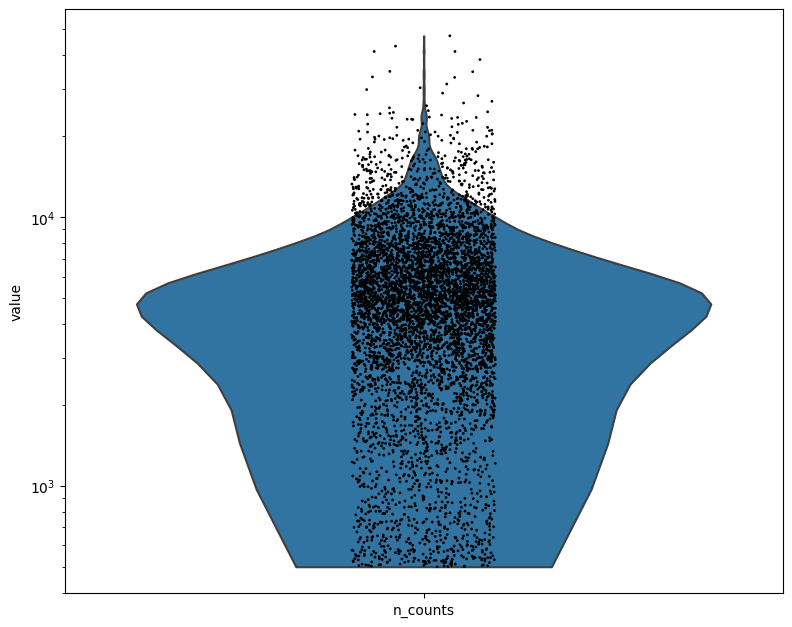

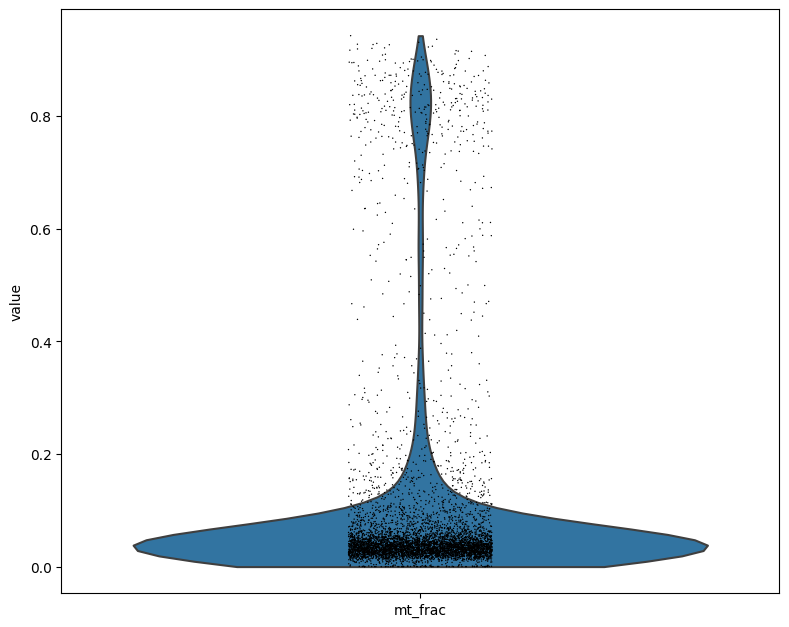

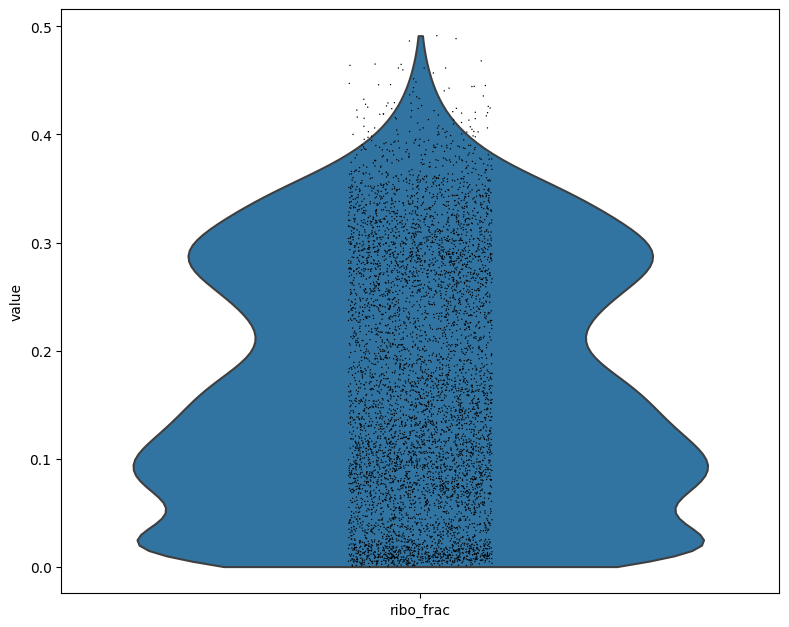

In [14]:
# Quality control - plot QC metrics
t1 = sc.pl.violin(adata_group[0], 'n_counts', size=2, log=True, cut=0)
t2 = sc.pl.violin(adata_group[0], 'mt_frac')
t3 = sc.pl.violin(adata_group[0], 'ribo_frac')

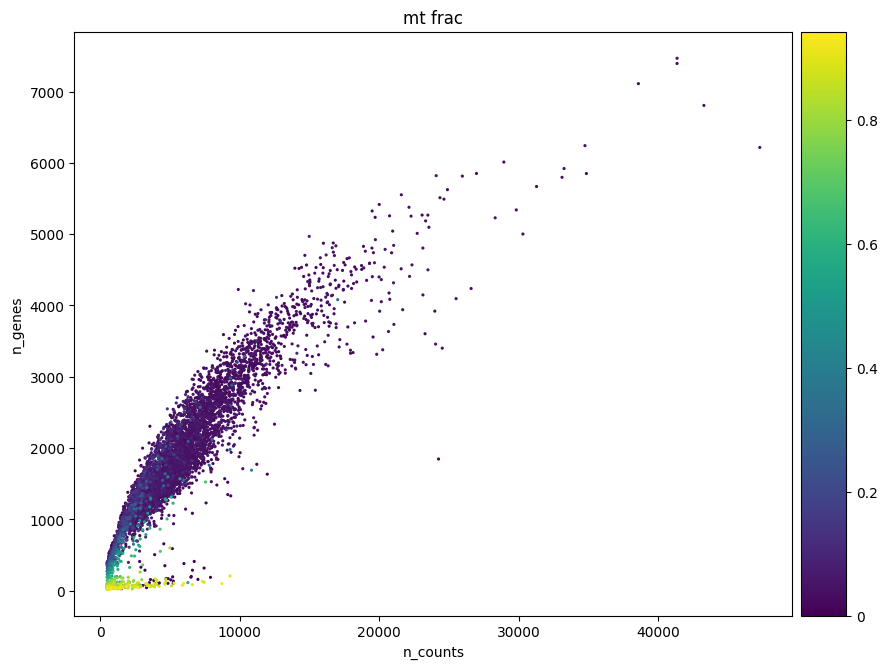

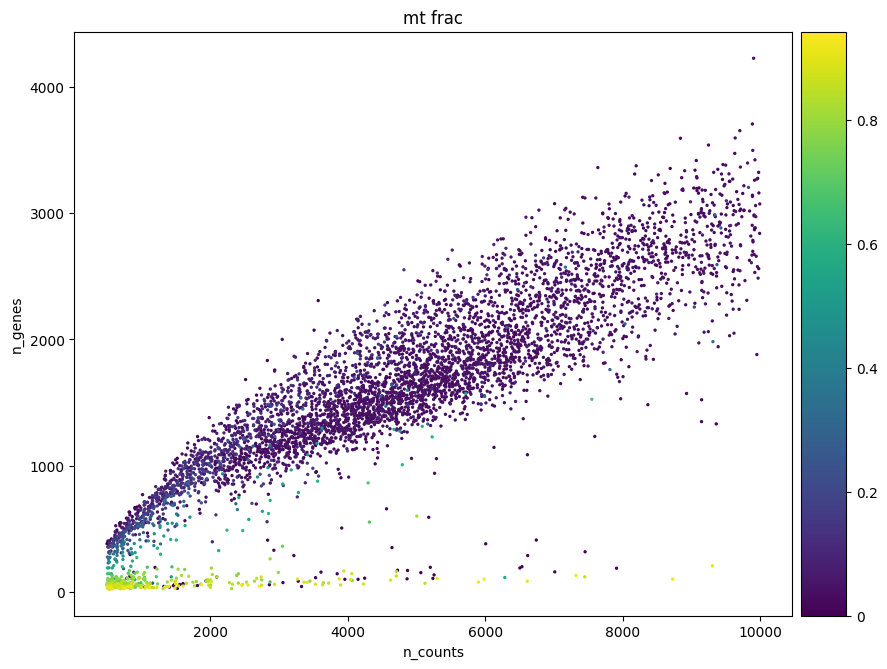

In [15]:
#Data quality summary plots
p1 = sc.pl.scatter(adata_group[0], 'n_counts', 'n_genes', color='mt_frac')
p2 = sc.pl.scatter(adata_group[0][adata_group[0].obs['n_counts']<10000], 'n_counts', 'n_genes', color='mt_frac')

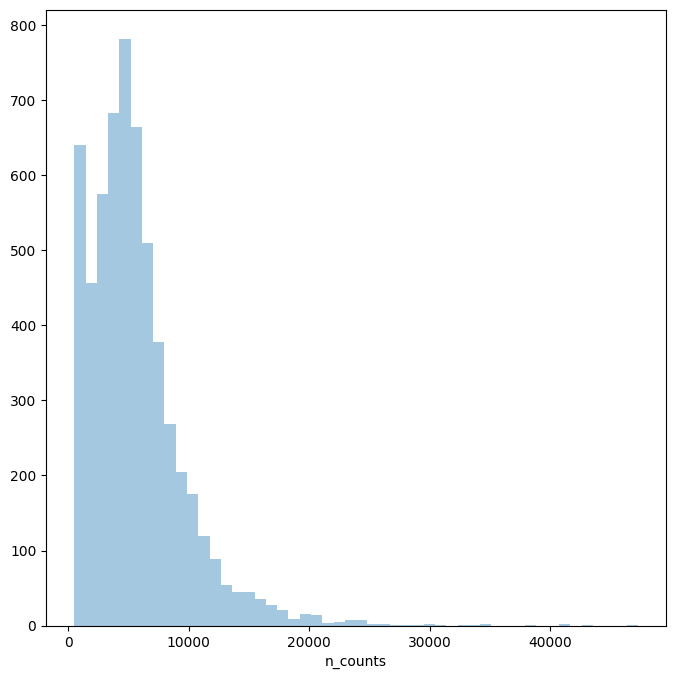

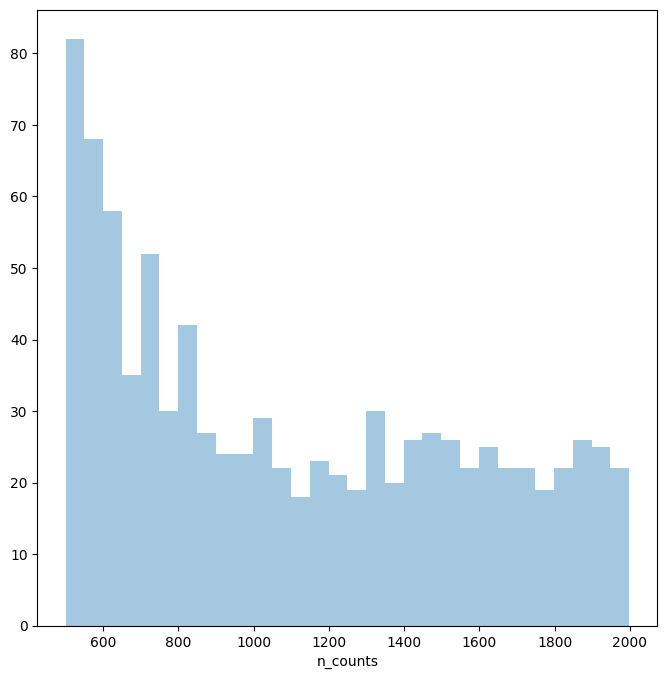

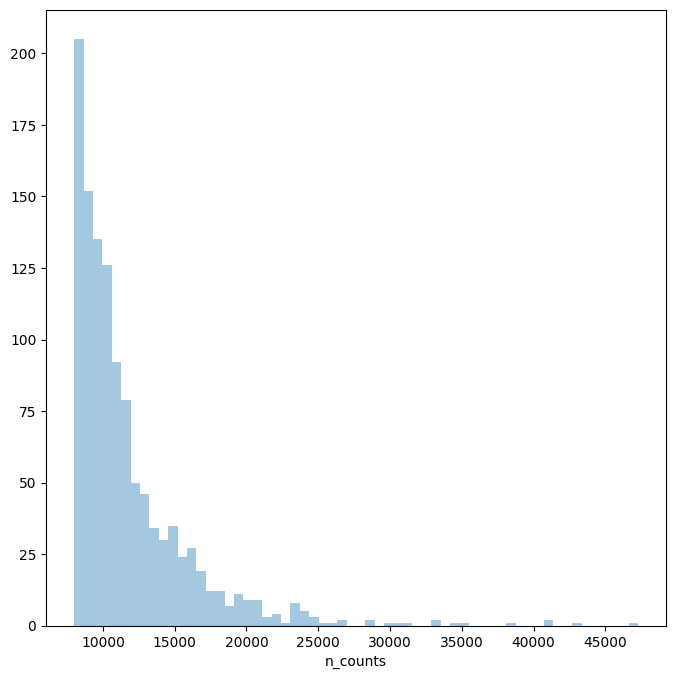

In [16]:
#Thresholding decision: counts
p3 = sns.distplot(adata_group[0].obs['n_counts'], kde=False)
plt.show()

p4 = sns.distplot(adata_group[0].obs['n_counts'][adata_group[0].obs['n_counts']<2000], kde=False, bins=30)
plt.show()

p5 = sns.distplot(adata_group[0].obs['n_counts'][adata_group[0].obs['n_counts']>8000], kde=False, bins=60)
plt.show()

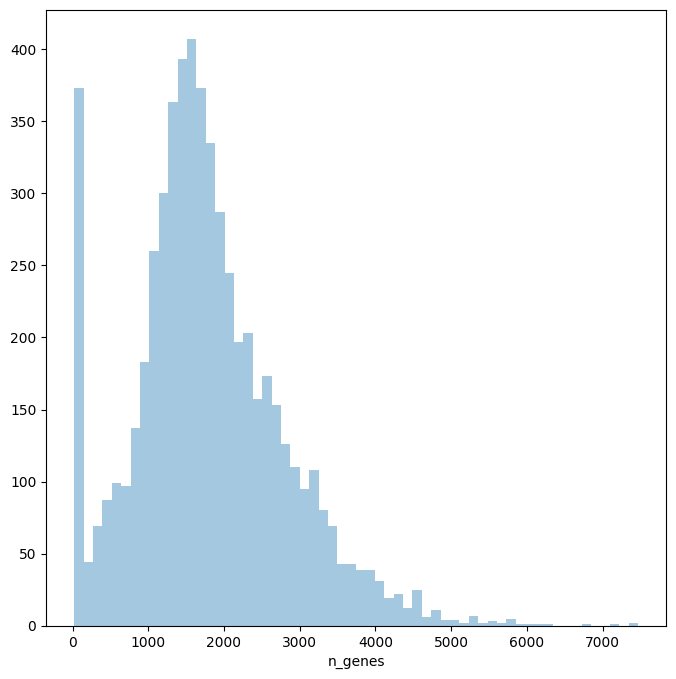

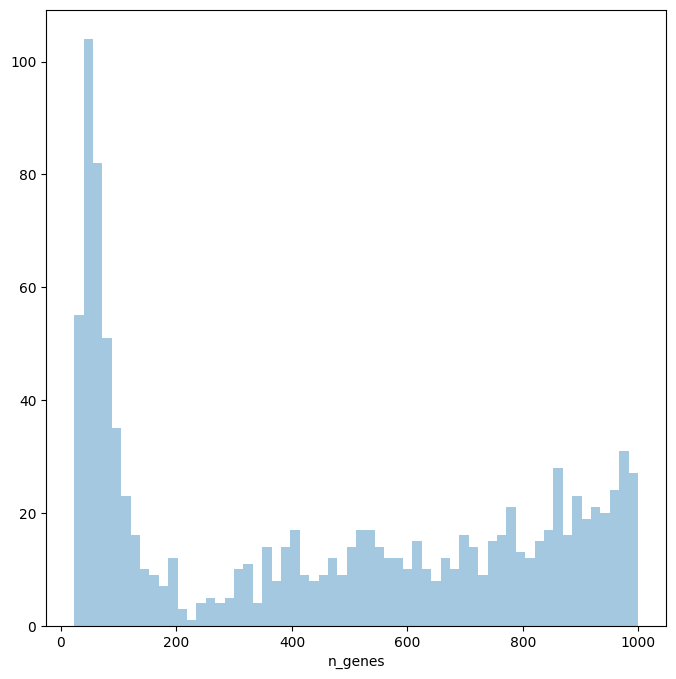

In [17]:
#Thresholding decision: genes
p6 = sns.distplot(adata_group[0].obs['n_genes'], kde=False, bins=60)
plt.show()

p7 = sns.distplot(adata_group[0].obs['n_genes'][adata_group[0].obs['n_genes']<1000], kde=False, bins=60)
plt.show()

In [18]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata_group[0].n_obs))

sc.pp.filter_cells(adata_group[0], min_counts = 1000)
print('Number of cells after min count filter: {:d}'.format(adata_group[0].n_obs))


adata_group[0] = adata_group[0][adata_group[0].obs['mt_frac'] < 0.2]
print('Number of cells after MT filter: {:d}'.format(adata_group[0].n_obs))

sc.pp.filter_cells(adata_group[0], min_genes = 200)
print('Number of cells after gene filter: {:d}'.format(adata_group[0].n_obs))


Total number of cells: 5850
filtered out 442 cells that have less than 1000 counts
Number of cells after min count filter: 5408
Number of cells after MT filter: 5160
filtered out 33 cells that have less than 200 genes expressed
Number of cells after gene filter: 5127


In [20]:
import doubletdetection
clf = doubletdetection.BoostClassifier(n_components = 50, n_top_var_genes = 3000)
# raw_counts is a cells by genes count matrix
labels = clf.fit(adata_group[0].X.A).predict()
# higher means more likely to be doublet
scores = clf.doublet_score()

  0%|          | 0/10 [00:00<?, ?it/s]

computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=50
    finished (0:00:00)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=50
    finished (0:00:00)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=50
    finished (0:00:00)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=50
    finished (0:00:00)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly repro

In [21]:
print('Number of cells before DP filter: {:d}'.format(adata_group[0].n_obs))
adata_group[0] = adata_group[0][labels == 0]
print('Number of cells after DP filter: {:d}'.format(adata_group[0].n_obs))

Number of cells before DP filter: 5127
Number of cells after DP filter: 5026


### 4 QC

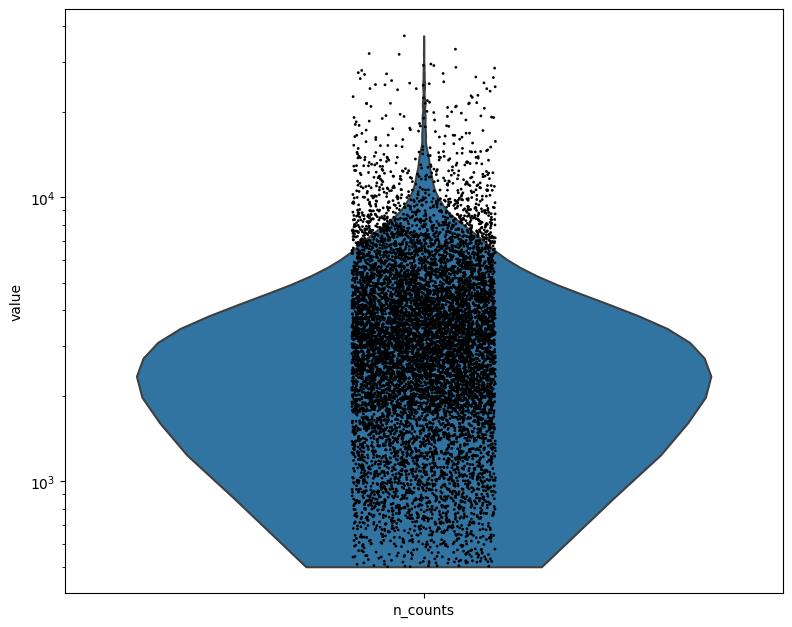

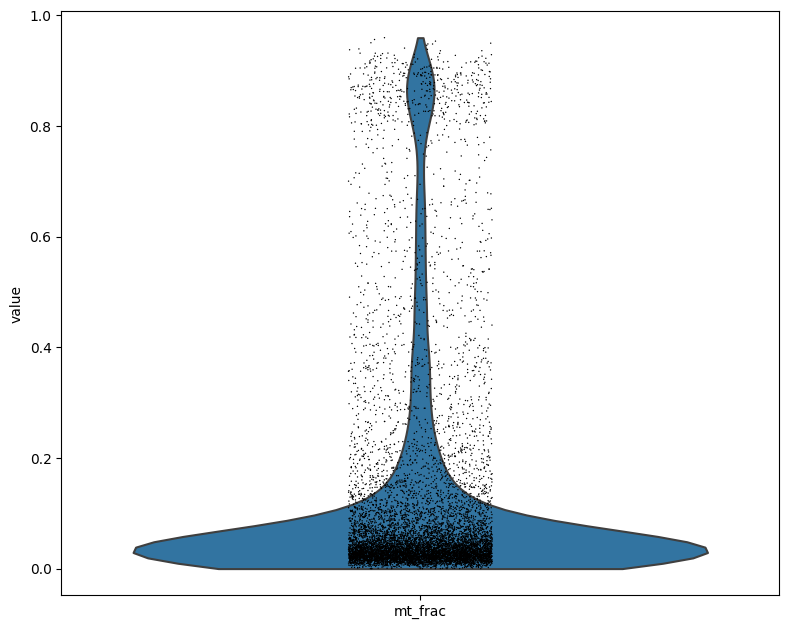

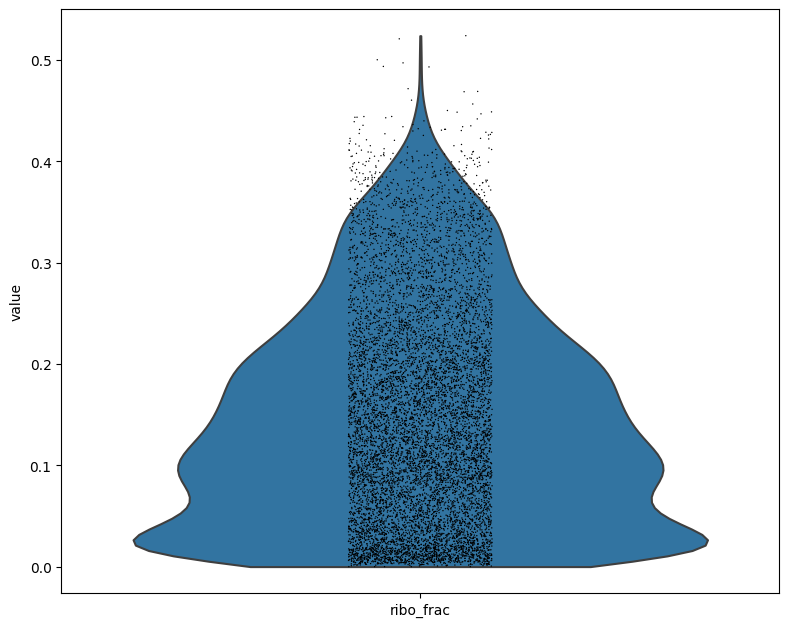

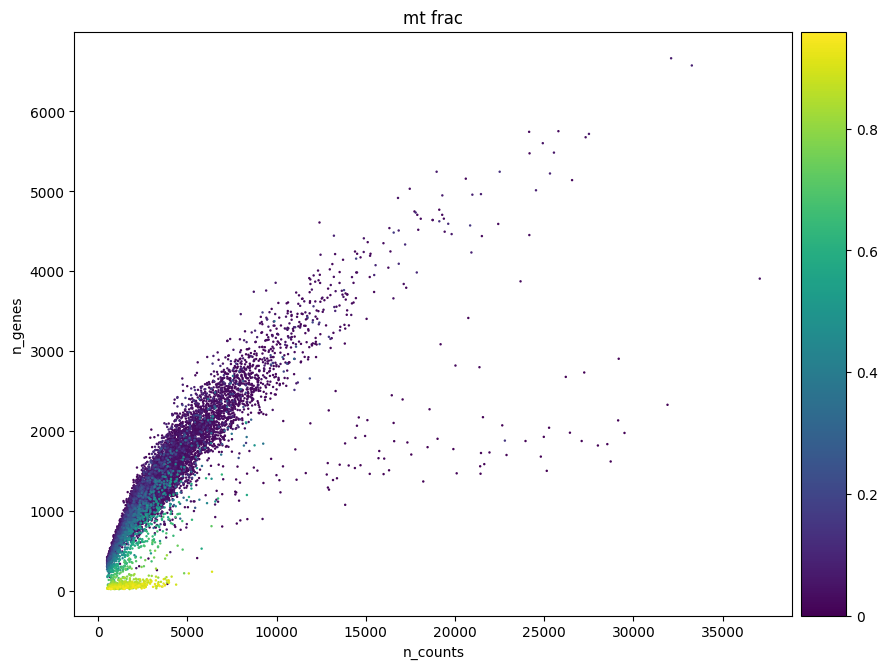

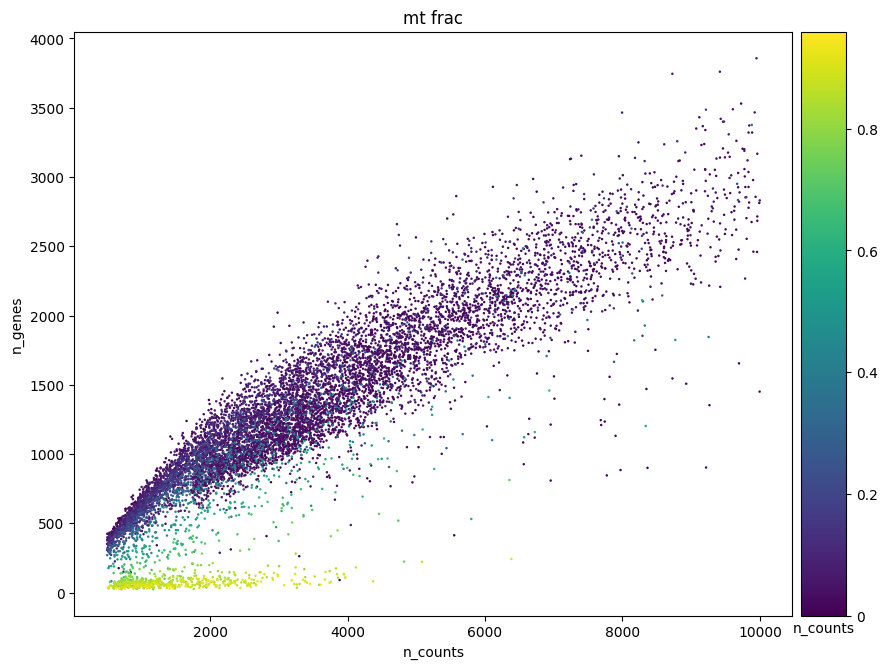

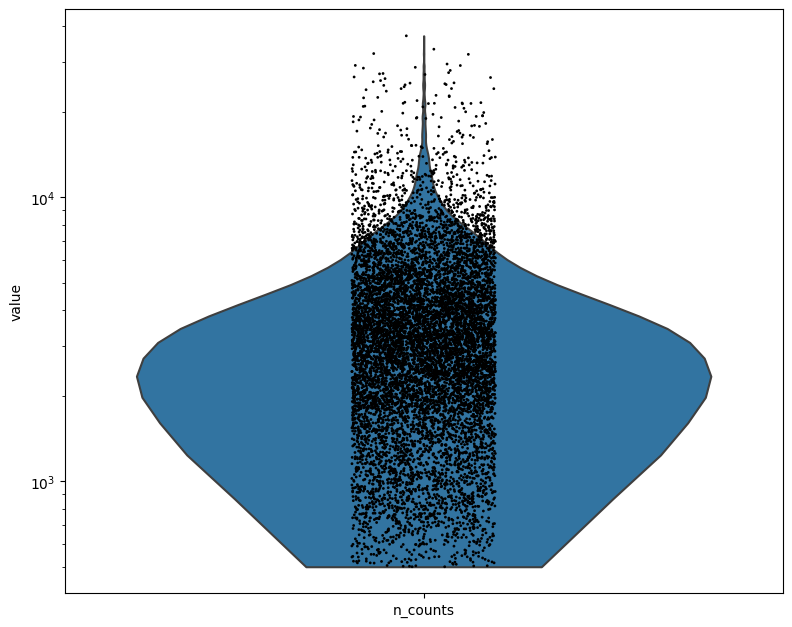

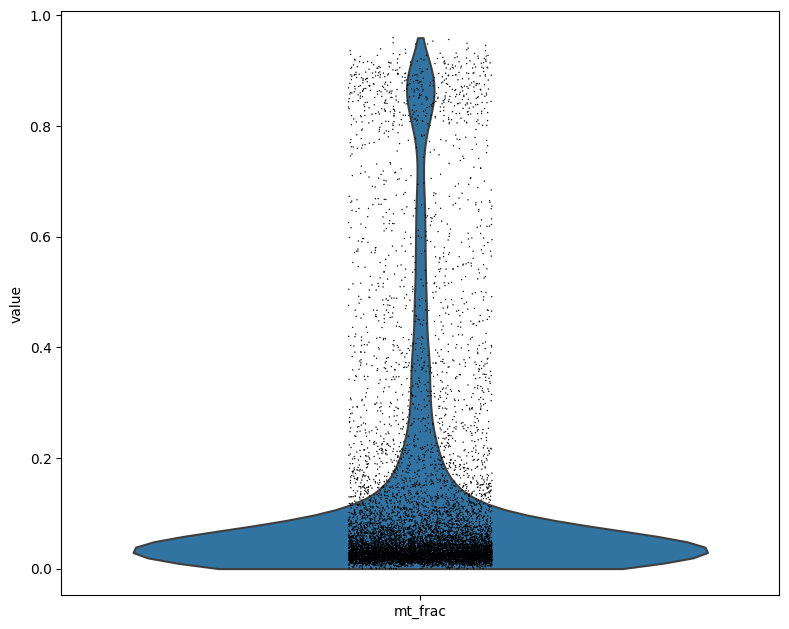

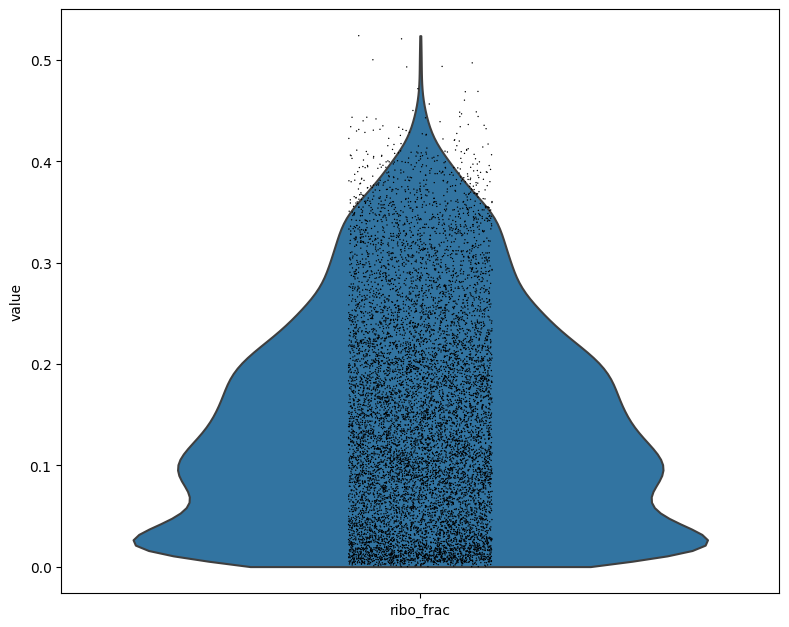

In [25]:
%matplotlib inline
t1 = sc.pl.violin(adata_group[1], 'n_counts', size=2, log=True, cut=0)
t2 = sc.pl.violin(adata_group[1], 'mt_frac')
t3 = sc.pl.violin(adata_group[1], 'ribo_frac')

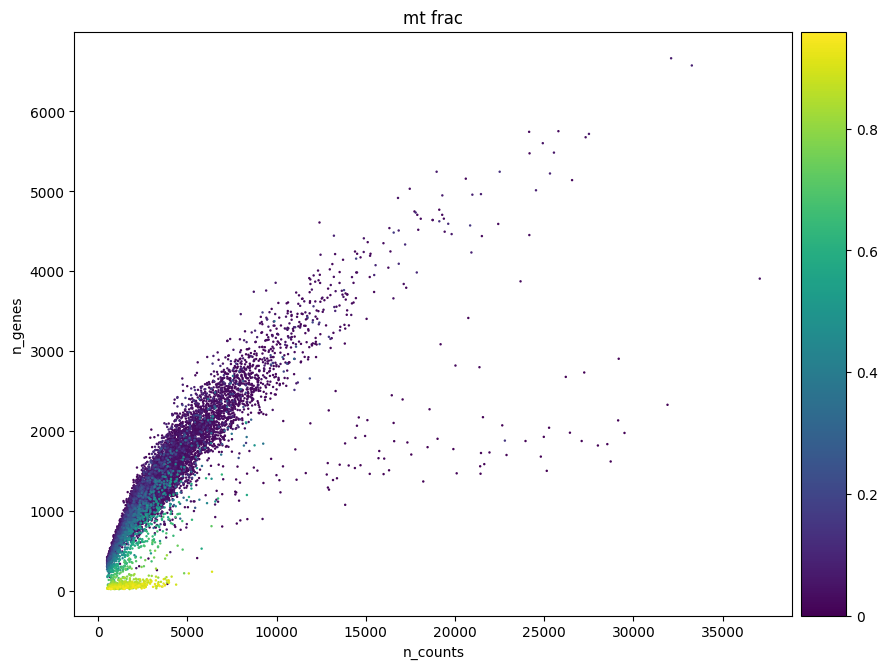

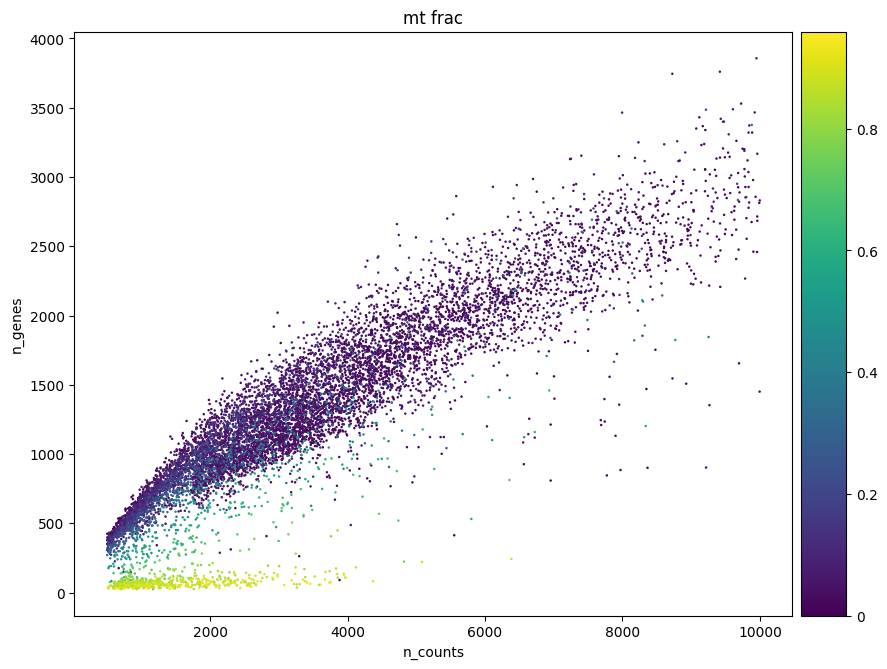

In [26]:
#Data quality summary plots
p1 = sc.pl.scatter(adata_group[1], 'n_counts', 'n_genes', color='mt_frac')
p2 = sc.pl.scatter(adata_group[1][adata_group[1].obs['n_counts']<10000], 'n_counts', 'n_genes', color='mt_frac')

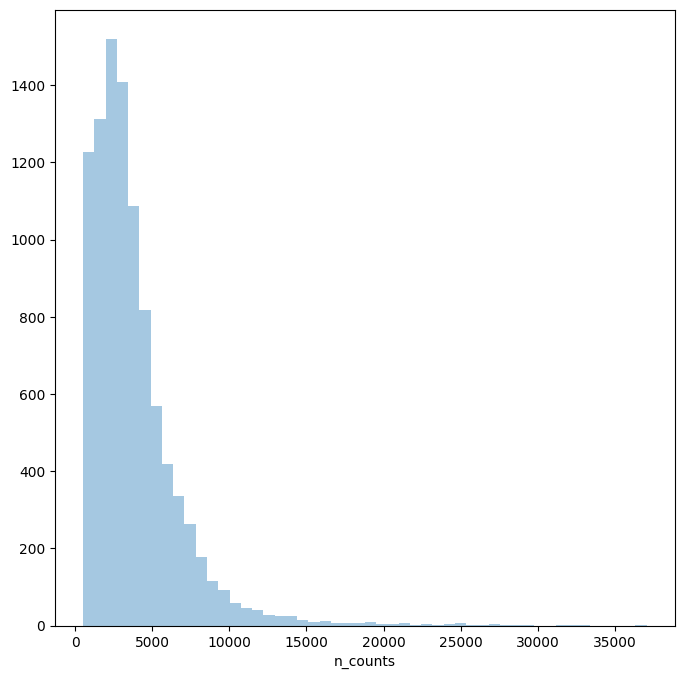

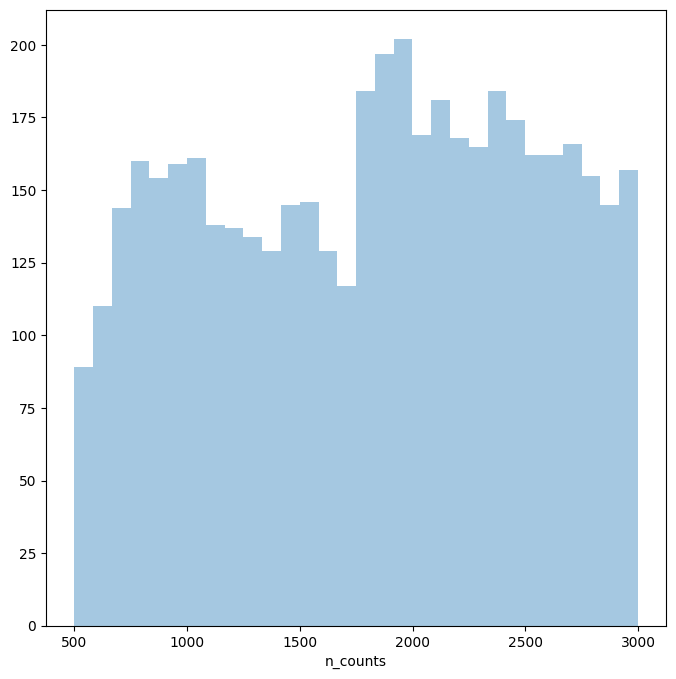

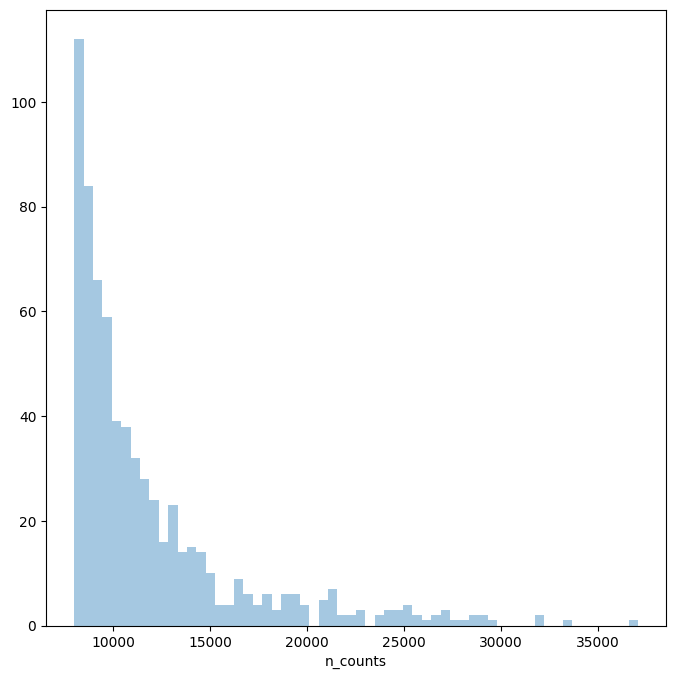

In [29]:
#Thresholding decision: counts
p3 = sns.distplot(adata_group[1].obs['n_counts'], kde=False)
plt.show()

p4 = sns.distplot(adata_group[1].obs['n_counts'][adata_group[1].obs['n_counts']<3000], kde=False, bins=30)
plt.show()

p5 = sns.distplot(adata_group[1].obs['n_counts'][adata_group[1].obs['n_counts']>8000], kde=False, bins=60)
plt.show()

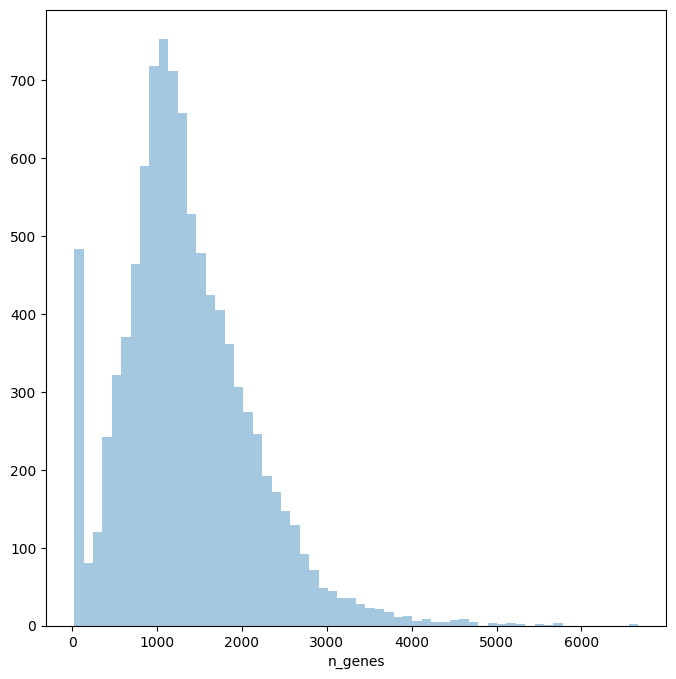

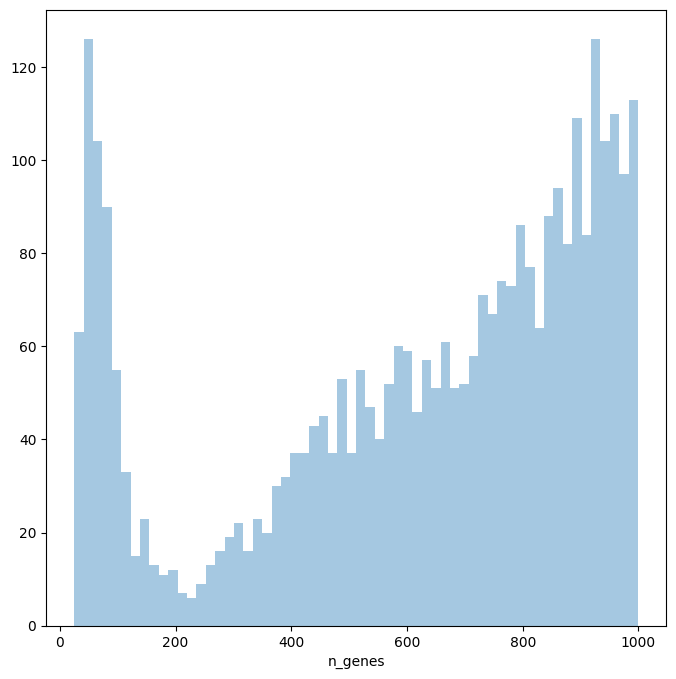

In [30]:
#Thresholding decision: genes
p6 = sns.distplot(adata_group[1].obs['n_genes'], kde=False, bins=60)
plt.show()

p7 = sns.distplot(adata_group[1].obs['n_genes'][adata_group[1].obs['n_genes']<1000], kde=False, bins=60)
plt.show()

In [31]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata_group[1].n_obs))

sc.pp.filter_cells(adata_group[1], min_counts = 1600)
print('Number of cells after min count filter: {:d}'.format(adata_group[1].n_obs))

adata_group[1] = adata_group[1][adata_group[1].obs['mt_frac'] < 0.2]
print('Number of cells after MT filter: {:d}'.format(adata_group[1].n_obs))

sc.pp.filter_cells(adata_group[1], min_genes = 200)
print('Number of cells after gene filter: {:d}'.format(adata_group[1].n_obs))

Total number of cells: 9686
filtered out 1834 cells that have less than 1600 counts
Number of cells after min count filter: 7852
Number of cells after MT filter: 6998
filtered out 1 cells that have less than 200 genes expressed
Number of cells after gene filter: 6997


In [32]:
clf = doubletdetection.BoostClassifier(n_components = 50, n_top_var_genes = 3000)
# raw_counts is a cells by genes count matrix
labels = clf.fit(adata_group[1].X.A).predict()
# higher means more likely to be doublet
scores = clf.doublet_score()

  0%|          | 0/10 [00:00<?, ?it/s]

computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=50
    finished (0:00:00)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=50
    finished (0:00:00)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=50
    finished (0:00:00)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=50
    finished (0:00:00)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly repro

In [33]:
print('Number of cells before T filter: {:d}'.format(adata_group[1].n_obs))
adata_group[1] = adata_group[1][labels == 0]
print('Number of cells after T filter: {:d}'.format(adata_group[1].n_obs))

Number of cells before T filter: 6997
Number of cells after T filter: 6628


### 5 QC

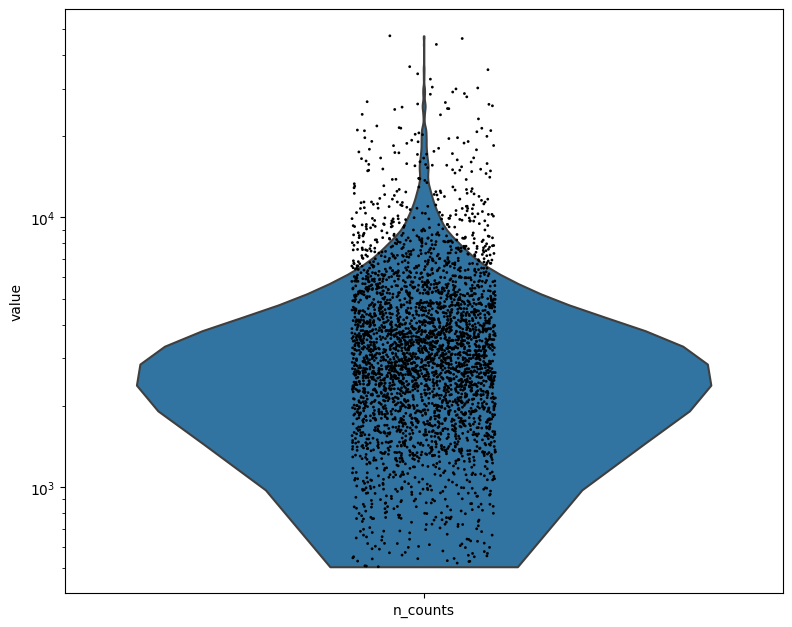

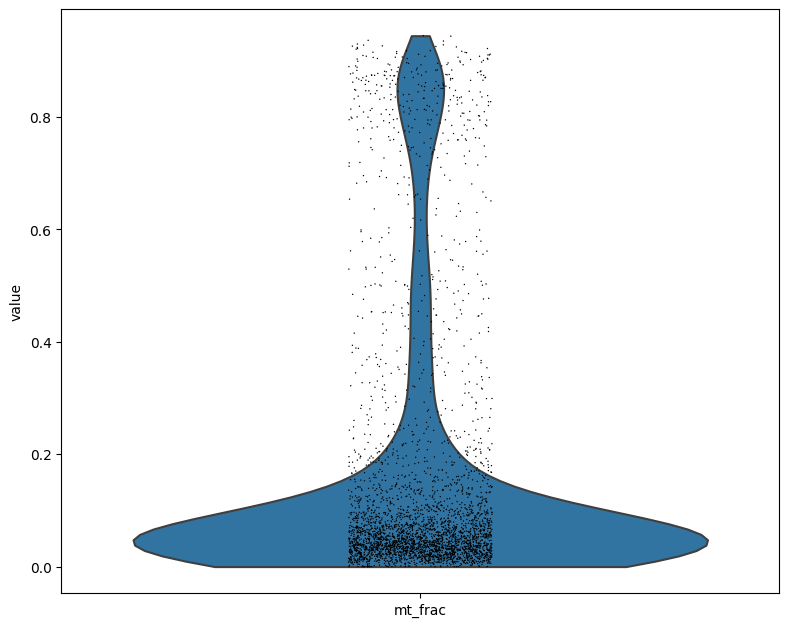

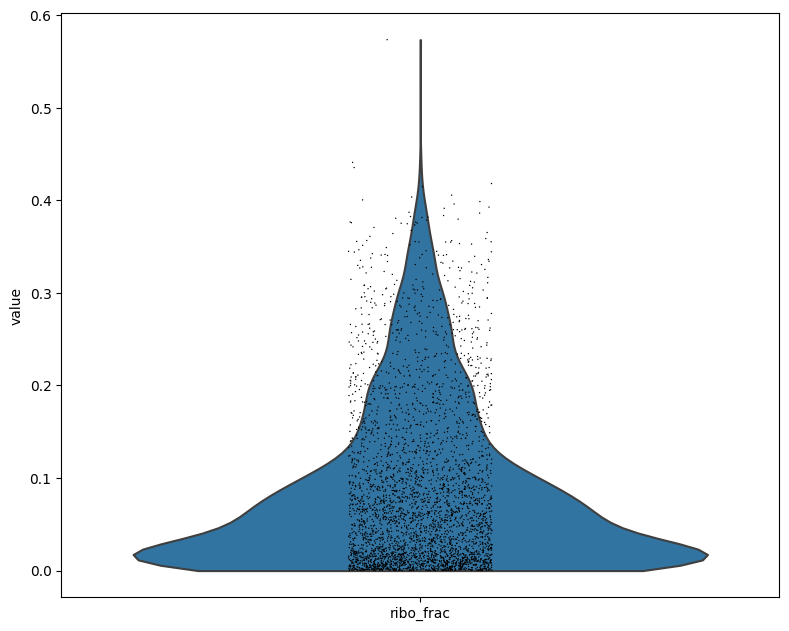

In [35]:
# Quality control - plot QC metrics
t1 = sc.pl.violin(adata_group[2], 'n_counts', size=2, log=True, cut=0)
t2 = sc.pl.violin(adata_group[2], 'mt_frac')
t3 = sc.pl.violin(adata_group[2], 'ribo_frac')


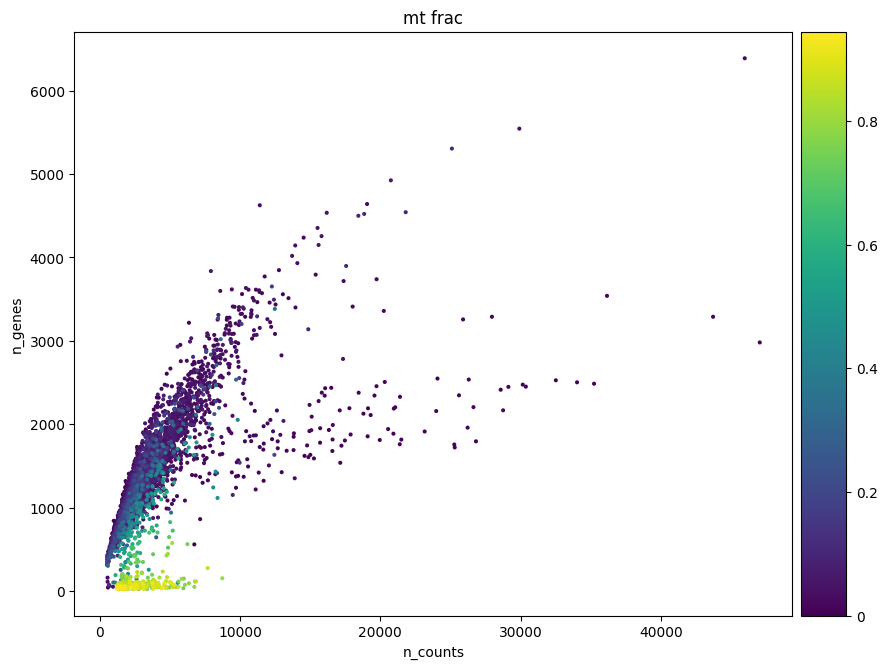

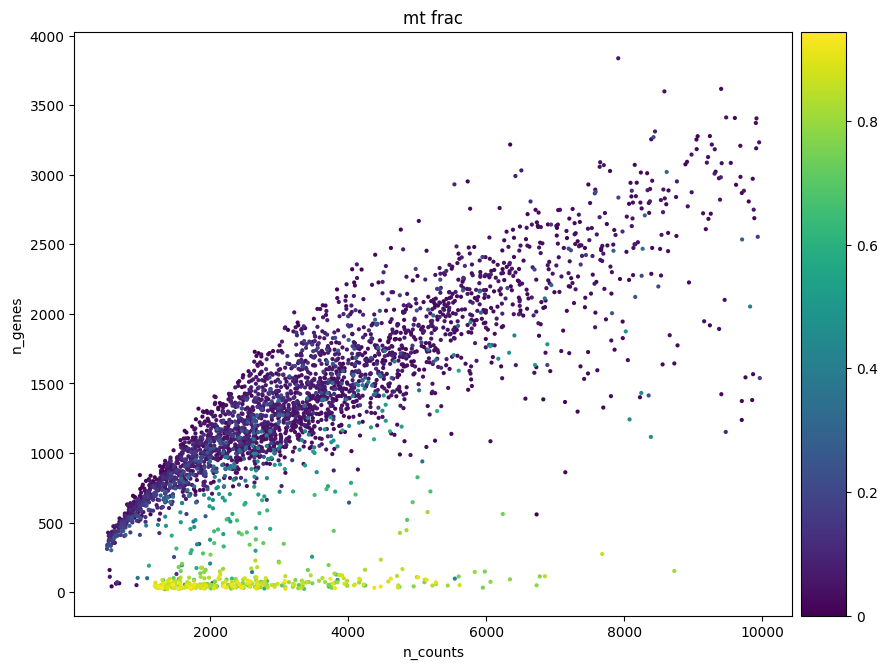

In [36]:
#Data quality summary plots
p1 = sc.pl.scatter(adata_group[2], 'n_counts', 'n_genes', color='mt_frac')
p2 = sc.pl.scatter(adata_group[2][adata_group[2].obs['n_counts']<10000], 'n_counts', 'n_genes', color='mt_frac')

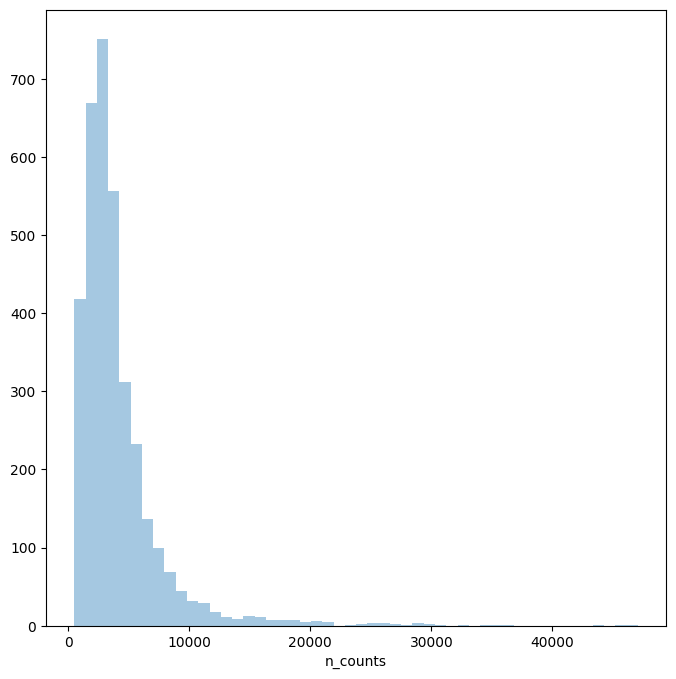

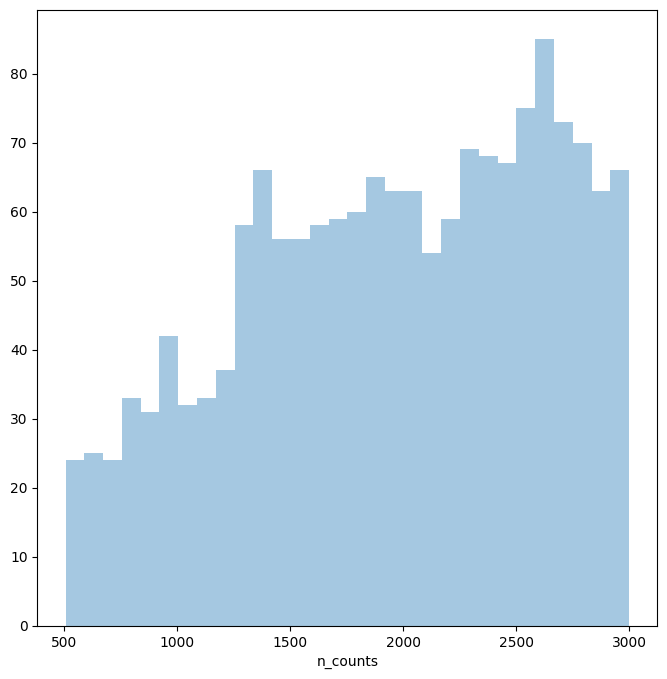

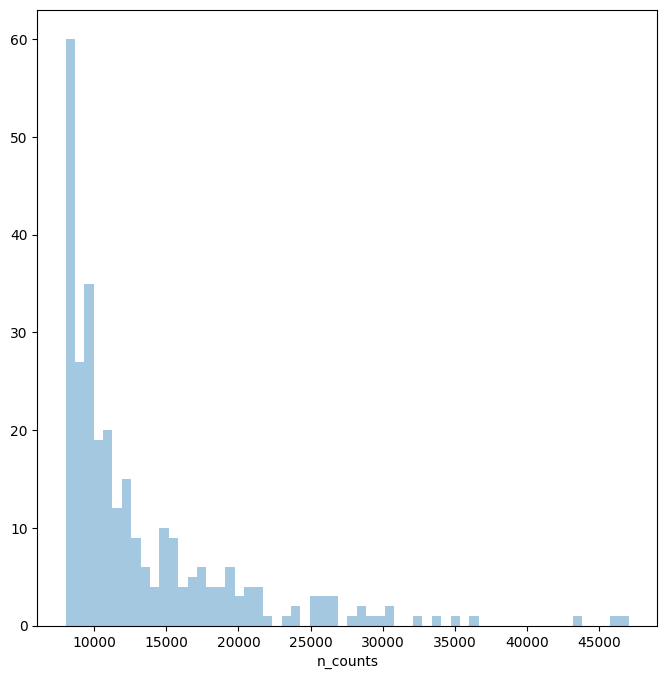

In [38]:
#Thresholding decision: counts
p3 = sns.distplot(adata_group[2].obs['n_counts'], kde=False)
plt.show()

p4 = sns.distplot(adata_group[2].obs['n_counts'][adata_group[2].obs['n_counts']<3000], kde=False, bins=30)
plt.show()

p5 = sns.distplot(adata_group[2].obs['n_counts'][adata_group[2].obs['n_counts']>8000], kde=False, bins=60)
plt.show()

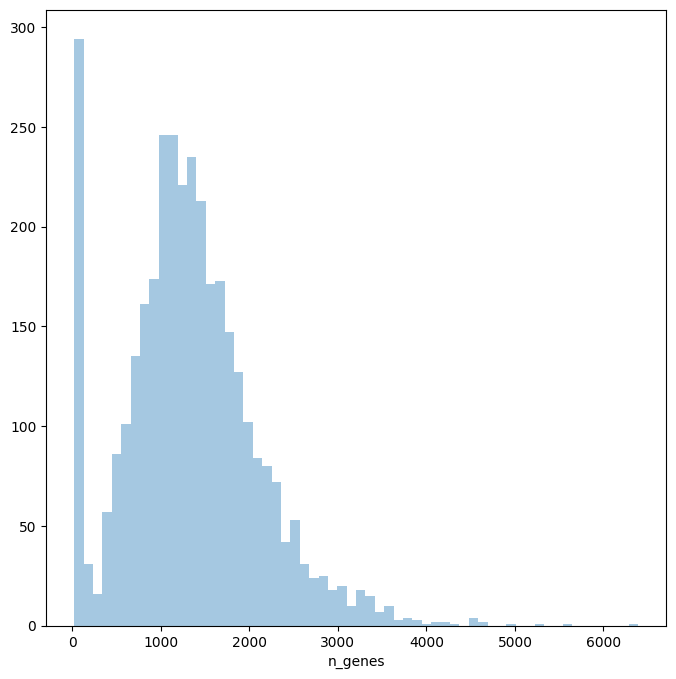

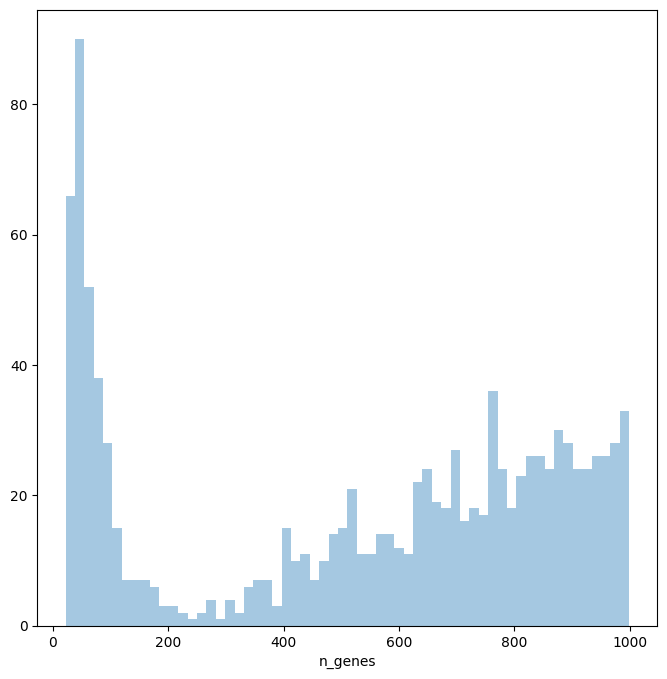

In [39]:
#Thresholding decision: genes
p6 = sns.distplot(adata_group[2].obs['n_genes'], kde=False, bins=60)
plt.show()

p7 = sns.distplot(adata_group[2].obs['n_genes'][adata_group[2].obs['n_genes']<1000], kde=False, bins=60)
plt.show()

In [40]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata_group[2].n_obs))

sc.pp.filter_cells(adata_group[2], min_counts = 1200)
print('Number of cells after min count filter: {:d}'.format(adata_group[2].n_obs))


adata_group[2] = adata_group[2][adata_group[2].obs['mt_frac'] < 0.2]
print('Number of cells after MT filter: {:d}'.format(adata_group[2].n_obs))

sc.pp.filter_cells(adata_group[2], min_genes = 200)
print('Number of cells after gene filter: {:d}'.format(adata_group[2].n_obs))


Total number of cells: 3471
filtered out 258 cells that have less than 1200 counts
Number of cells after min count filter: 3213
Number of cells after MT filter: 2580
filtered out 2 cells that have less than 200 genes expressed
Number of cells after gene filter: 2578


In [41]:
clf = doubletdetection.BoostClassifier(n_components = 50, n_top_var_genes = 3000)
# raw_counts is a cells by genes count matrix
labels = clf.fit(adata_group[2].X.A).predict()
# higher means more likely to be doublet
scores = clf.doublet_score()

  0%|          | 0/10 [00:00<?, ?it/s]

computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=50
    finished (0:00:00)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=50
    finished (0:00:00)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=50
    finished (0:00:00)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.`
    with n_comps=50
    finished (0:00:00)
computing PCA
Note that scikit-learn's randomized PCA might not be exactly repro

In [42]:
print('Number of cells before T filter: {:d}'.format(adata_group[2].n_obs))
adata_group[2] = adata_group[2][labels == 0]
print('Number of cells after T filter: {:d}'.format(adata_group[2].n_obs))

Number of cells before T filter: 2578
Number of cells after T filter: 2564


### concat

In [43]:
adata_concat = adata_group[0].concatenate(adata_group[1],adata_group[2], batch_categories=['3', '4','5'])

In [44]:
sc.pp.filter_genes(adata_concat, min_cells = 2)

filtered out 7550 genes that are detected in less than 2 cells


In [45]:
adata_concat.layers['raw_filtered'] = adata_concat.X

In [46]:
adata_concat.obs['n_counts'] = adata_concat.X.sum(1)
adata_concat.obs['log_counts'] = np.log(adata_concat.obs['n_counts'])
adata_concat.obs['n_genes'] = (adata_concat.X > 0).sum(1)
adata_concat.obs['log10GenesPerUMI'] = np.log10(adata_concat.obs['n_genes'])/np.log10(adata_concat.obs['n_counts'])

mt_gene_mask = [gene.startswith('MT-') for gene in adata_concat.var_names]
adata_concat.obs['mt_frac'] = np.array(adata_concat.X[:, mt_gene_mask].sum(1).ravel())[0]/adata_concat.obs['n_counts']
ribo_gene_mask = [gene.startswith('RPL') or gene.startswith('RPS') for gene in adata_concat.var_names]
adata_concat.obs['ribo_frac'] = np.array(adata_concat.X[:, ribo_gene_mask].sum(1).ravel())[0]/adata_concat.obs['n_counts']

In [47]:
adata_forcycle = adata_concat.copy()
sc.pp.normalize_total(adata_forcycle, key_added = 'normalization_factors')
sc.pp.log1p(adata_forcycle)

normalizing counts per cell
    finished (0:00:00)


### Find HVG and proceed to dimesion reduction PCA + UMAP

In [48]:
sc.pp.highly_variable_genes(adata_forcycle, flavor='seurat', n_top_genes=2000)
print('\n','Number of highly variable genes: {:d}'.format(np.sum(adata_forcycle.var['highly_variable'])))

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)

 Number of highly variable genes: 2000


In [49]:
sc.pp.pca(adata_forcycle, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata_forcycle, n_neighbors = 15, n_pcs = 50)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:22)


In [50]:
sc.tl.umap(adata_forcycle, min_dist = 0.2, spread = 1)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:09)


### Use the cell cycle gene list summarized by Triosh et al. to calculate the cc score

In [51]:
cc_genes = pd.read_excel('Triosh_cc.xlsx')

In [52]:
s_genes = cc_genes['G1/S'].dropna()
g2m_genes = cc_genes['G2/M'].dropna()

s_genes_mm_ens = adata_forcycle.var_names[np.in1d(adata_forcycle.var_names, s_genes)]
g2m_genes_mm_ens = adata_forcycle.var_names[np.in1d(adata_forcycle.var_names, g2m_genes)]

In [53]:
sc.tl.score_genes_cell_cycle(adata_forcycle, s_genes=s_genes_mm_ens, g2m_genes=g2m_genes_mm_ens)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    502 total control genes are used. (0:00:00)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    588 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)


### Visualize the cell phases of the co-cultured cells

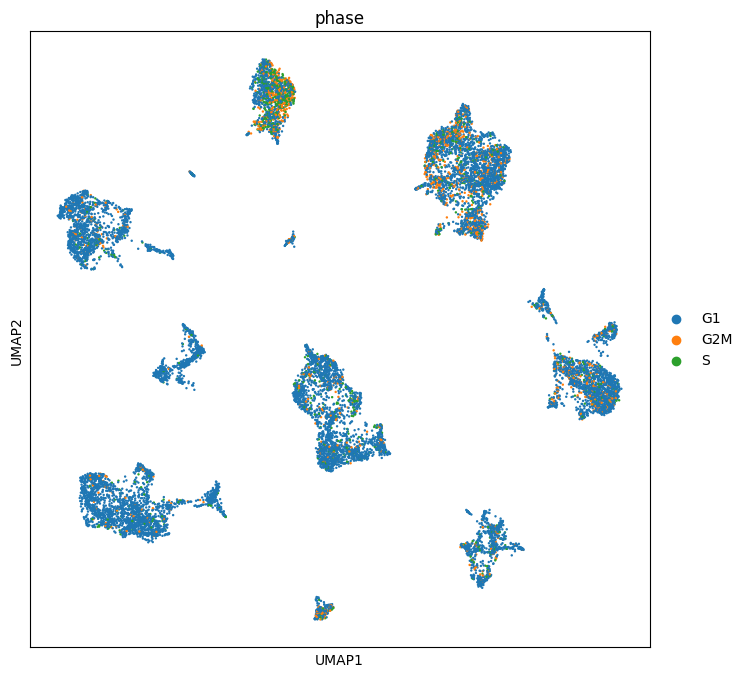

In [54]:
sc.pl.umap(adata_forcycle, color='phase',size = 12)

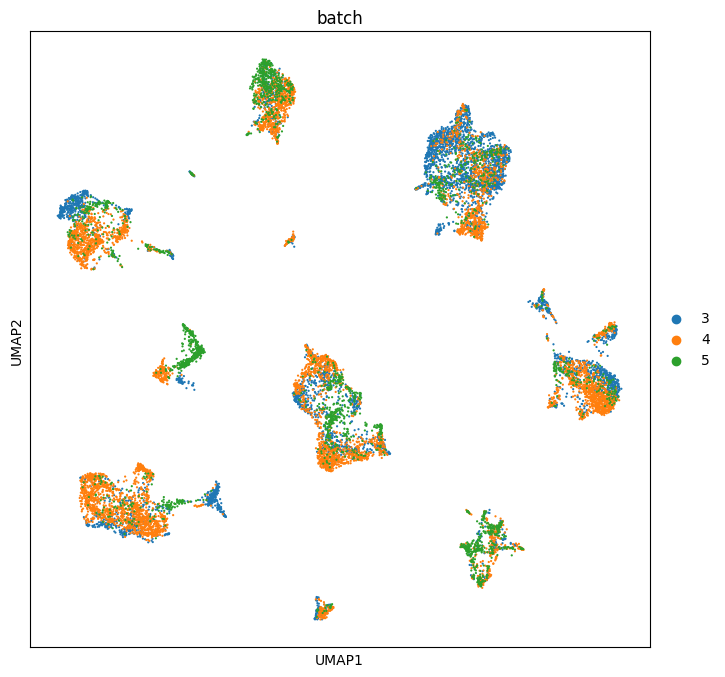

In [55]:
sc.pl.umap(adata_forcycle, color='batch',size = 10)

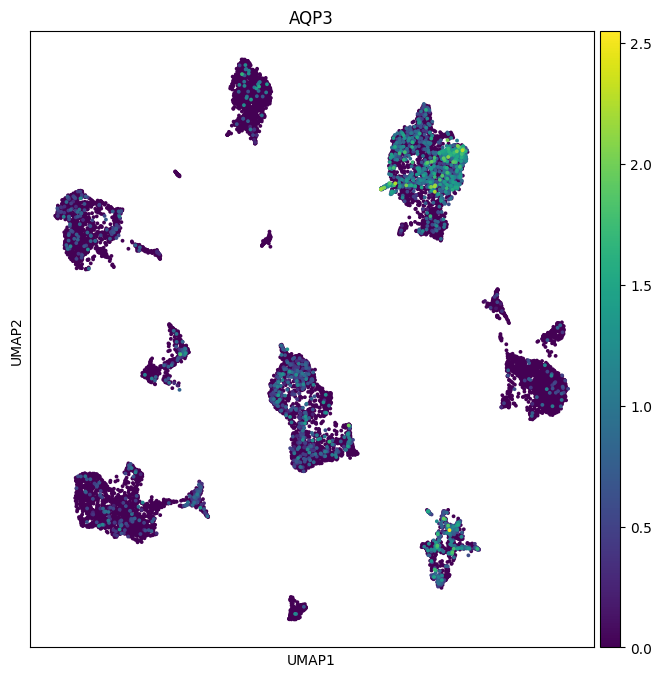

In [61]:
sc.pl.umap(adata_forcycle, color='AQP3',size = 30)

### Export the result to input it into the Seurat

In [62]:
Sscore = adata_forcycle.obs['S_score'].values.tolist()
G2Mscore = adata_forcycle.obs['G2M_score'].values.tolist()
S_G2M_diff = adata_forcycle.obs['S_score'] - adata_forcycle.obs['G2M_score']
S_G2M_diff = S_G2M_diff.values.tolist()

In [63]:
adata_concat.uns['allgenes'] = list(adata_concat.var_names)
adata_concat.obs['S_score'] = adata_forcycle.obs['S_score']
adata_concat.obs['G2M_score'] = adata_forcycle.obs['G2M_score']
adata_concat.obs['S_G2M_diff'] = adata_concat.obs['S_score'] - adata_concat.obs['G2M_score']
adata_concat.obs['phase'] = adata_forcycle.obs['phase']

In [64]:
colnames = adata_concat.obs_names
rownames = adata_concat.var_names
mt_frac = adata_concat.obs['mt_frac']
batch = adata_concat.obs['batch']
counts = adata_concat.X.T

In [65]:
%%R -i counts -i colnames -i rownames -i S_G2M_diff -i mt_frac -i Sscore -i G2Mscore -i batch
colnames(counts) = colnames
rownames(counts) = rownames

srat <- CreateSeuratObject(counts = counts, project = "gut", min.cells = 0, min.features = 0, assay = "RNA")

srat[["S_G2M_diff"]] = S_G2M_diff
srat[["mt_frac"]] = mt_frac
srat[["Sscore"]] = Sscore
srat[["G2Mscore"]] = G2Mscore
srat[["batch"]] = batch

In [66]:
%%R
cond.list = SplitObject(srat, split.by = "batch")
d3 <- cond.list[["3"]]
d4 <- cond.list[["4"]]
d5 <- cond.list[["5"]]

d3 = SCTransform(object = d3, verbose = FALSE, vst.flavor = "v2", vars.to.regress = c("G2Mscore","Sscore","mt_frac"),min_cells=0) #c("G2Mscore","Sscore"))

d3 = RunPCA(d3, verbose = FALSE)

d4 = SCTransform(object = d4, verbose = FALSE, vst.flavor = "v2", vars.to.regress = c("G2Mscore","Sscore","mt_frac"),min_cells=0) #c("G2Mscore","Sscore"))

d4 = RunPCA(d4, verbose = FALSE)

d5 = SCTransform(object = d5, verbose = FALSE, vst.flavor = "v2", vars.to.regress = c("G2Mscore","Sscore","mt_frac"),min_cells=0) #c("G2Mscore","Sscore"))

d5 = RunPCA(d5, verbose = FALSE)

In [67]:
%%R
ifnb.list <- list(d3 = d3, d4 = d4, d5 = d5)
features <- SelectIntegrationFeatures(object.list = ifnb.list, nfeatures = 3000)
ifnb.list <- PrepSCTIntegration(object.list = ifnb.list, anchor.features = features)

mod.anchors <- FindIntegrationAnchors(object.list = ifnb.list, normalization.method = "SCT",
    anchor.features = features)
srat_combined <- IntegrateData(anchorset = mod.anchors, normalization.method = "SCT")

  |                                                  | 0 % ~calculating   |+++++++++++++++++                                 | 33% ~03s           |++++++++++++++++++++++++++++++++++                | 67% ~02s           |++++++++++++++++++++++++++++++++++++++++++++++++++| 100% elapsed=05s  
  |                                                  | 0 % ~calculating   |+++++++++++++++++                                 | 33% ~04m 34s       |++++++++++++++++++++++++++++++++++                | 67% ~01m 39s       |++++++++++++++++++++++++++++++++++++++++++++++++++| 100% elapsed=04m 40s
[1] 1
[1] 2
[1] 3


In [70]:
%%R -o HVG -o varExplained -o PCs -o mat -o left_genes

srat_combined = RunPCA(srat_combined,verbose = FALSE)

HVG = VariableFeatures(srat_combined)

mat <- Seurat::GetAssayData(object = srat_combined, slot = 'scale.data')
pca <- srat_combined[["pca"]]

# Get the total variance:
total_variance <- sum(matrixStats::rowVars(mat))

eigValues = (pca@stdev)^2  ## EigenValues
varExplained = eigValues / total_variance

PCs = Loadings(srat_combined, reduction = "pca")
left_genes = rownames(x = srat_combined[["SCT"]])

saveRDS(srat_combined,'F:/Tcell_tissues/srat_combined_gut.rds')

In [74]:
%%R -o X_pca
X_pca = pca@cell.embeddings

In [71]:
%%R -o counts -o logcounts -o residuals

counts = srat_combined[["SCT"]]@counts
logcounts = srat_combined[["SCT"]]@data
residuals = srat_combined[["SCT"]]@scale.data

In [72]:
%R -o srat_combined -o features

In [76]:
import anndata
adata = anndata.AnnData(X = logcounts.T)
adata.var_names = left_genes
adata.obs_names = adata_concat.obs_names
adata.obs = adata_concat.obs
adata.uns['scaled'] = mat.T
adata.layers['counts'] = counts.T
adata.uns['residuals'] = residuals.T
adata.layers['logcounts'] = logcounts.T
adata.layers['raw'] = adata_concat.layers['raw_filtered']
adata.obsm['X_pca'] = X_pca

In [77]:
adata.obs['n_counts'] = adata.layers['counts'].sum(1)
adata.obs['n_genes'] = (adata.layers['counts'] > 0).sum(1)
adata.var['highly_variable'] = adata.var_names.isin(HVG)
adata.obs['phase'] = adata_concat.obs['phase']
adata.uns['pca'] = dict({'variance_ratio': varExplained})

In [78]:
mt_gene_mask = [gene.startswith('MT-') for gene in adata.var_names]
adata.obs['mt_frac'] = np.array(adata.layers['counts'][:, mt_gene_mask].sum(1).ravel())[0]/adata.obs['n_counts']

In [79]:
ribo_gene_mask = [gene.startswith('RPL') or gene.startswith('RPS') for gene in adata.var_names]
adata.obs['ribo_frac'] = np.array(adata.layers['counts'][:, ribo_gene_mask].sum(1).ravel())[0]/adata.obs['n_counts']

In [80]:
sc.pp.neighbors(adata, n_pcs = 50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


running Leiden clustering
    finished: found 16 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


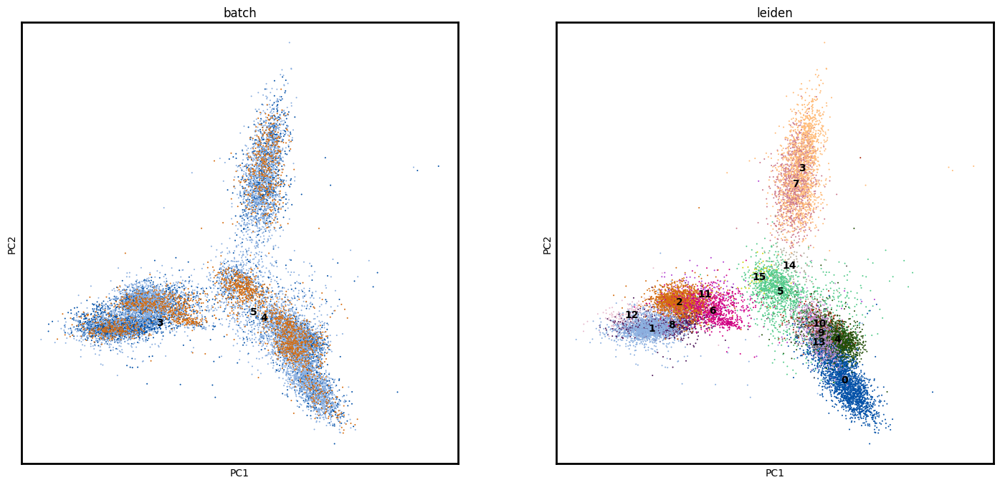

In [34]:
sc.tl.leiden(adata, resolution = 0.3, key_added= 'leiden')
sc.pl.pca(adata, color=['batch','leiden'], legend_loc = 'on data')

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


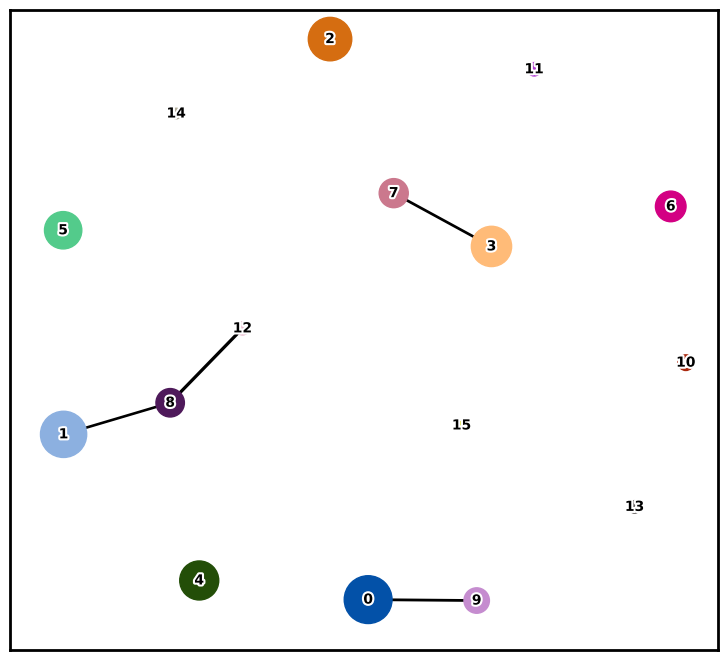

In [38]:
sc.tl.paga(adata, groups='leiden')
sc.pl.paga(adata,threshold = 0.2, labels=None, fontsize = 10, fontoutline = 3,node_size_scale = 3,node_size_power = 1,random_state = 0)

In [39]:
%matplotlib inline
sc.tl.umap(adata, min_dist = 0.001, spread = 1.5,init_pos = 'paga')

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:07)


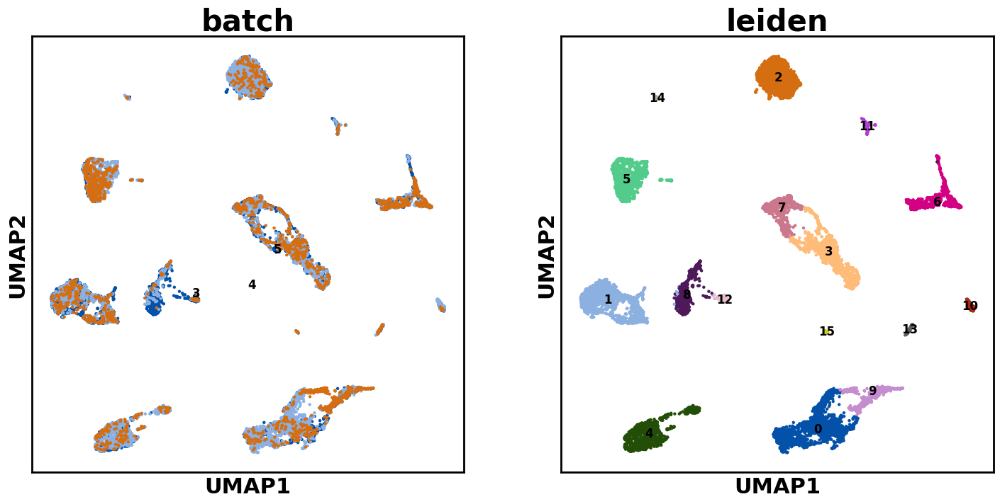

In [45]:
#plt.close()
plt.rcParams['axes.linewidth'] = 2
fig = sc.pl.umap(adata, color = ['batch','leiden'],
                 size = 40, legend_loc = 'on data', palette  = my_palette, ncols = 4, cmap = my_cmap, return_fig = True, legend_fontsize = 'large')
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
#plt.savefig('overall_map_withunmatched.png')

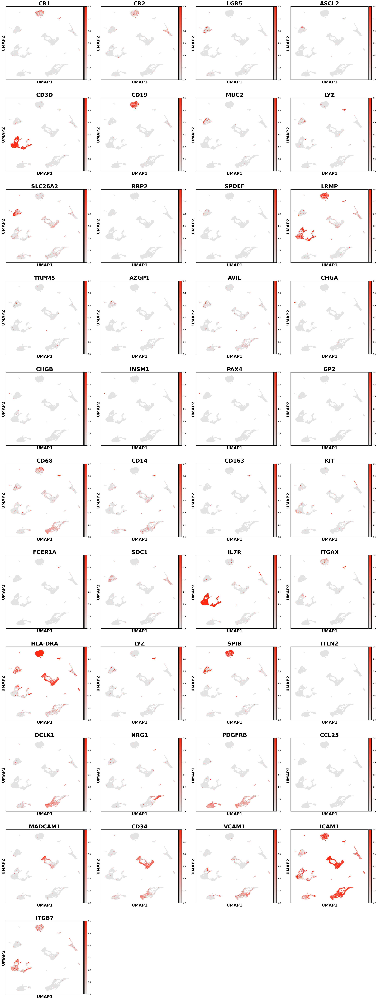

In [17]:
#plt.close()
%matplotlib inline
plt.rcParams['axes.linewidth'] = 2
fig = sc.pl.umap(adata, color = ['CR1','CR2','LGR5','ASCL2','CD3D','CD19','MUC2','LYZ',
                                 'SLC26A2','RBP2','SPDEF','LRMP', 'TRPM5','AZGP1','AVIL',
                                'CHGA', 'CHGB', 'INSM1','PAX4','GP2',
                                'CD68','CD14','CD163','KIT','FCER1A','SDC1','IL7R','ITGAX','HLA-DRA',
                                'LYZ','SPIB','ITLN2','DCLK1','NRG1','PDGFRB','CCL25','MADCAM1','CD34','VCAM1','ICAM1','ITGB7'],
                 size = 40, legend_loc = 'on data', palette  = my_palette, ncols = 4, vmax = 3, cmap = my_cmap, return_fig = True, legend_fontsize = 'large')
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
#plt.savefig('overall_map_withunmatched.png')

In [66]:
def DE_to_df(_adata, rank_key, _padj_thresh=0.05, _logfc_thresh=1):
    def process_genes(i, direction):
        _log2foldmask = (_adata.uns[rank_key]['logfoldchanges'][i].astype('double') >= _logfc_thresh) if direction == "up" else (_adata.uns[rank_key]['logfoldchanges'][i].astype('double') <= -_logfc_thresh)
        _pvalmask = _adata.uns[rank_key]['pvals_adj'][i].astype('double') <= _padj_thresh
        _additional = pd.DataFrame({
            i: _adata.uns[rank_key]['names'][i].astype('str')[_log2foldmask & _pvalmask],
            'logfoldchanges_'+i: np.abs(_adata.uns[rank_key]['logfoldchanges'][i].astype('double')[_log2foldmask & _pvalmask])
        })
        _ribo_gene_mask = [gene.startswith('RPL') or gene.startswith('RPS') for gene in _additional[i]]
        _mt_gene_mask = [gene.startswith('MT-') for gene in _additional[i]]
        if len(_ribo_gene_mask)>0 and len(_mt_gene_mask)>0:
            _drop_id = np.array(np.array(_ribo_gene_mask) | np.array(_mt_gene_mask))
            _additional = _additional.sort_values(by='logfoldchanges_'+i, ascending=False)
            _additional = _additional.iloc[_drop_id==False, :].reset_index(drop=True)
        return _additional

    _pass_genes_up = pd.DataFrame()
    _pass_genes_down = pd.DataFrame()

    for i in set(_adata.uns[rank_key]['pvals_adj'].dtype.names):

        _pass_genes_up = pd.concat([_pass_genes_up, process_genes(i, "up")[i]], ignore_index=False, axis=1)
        _pass_genes_down = pd.concat([_pass_genes_down, process_genes(i, "down")[i]], ignore_index=False, axis=1)

        
    return _pass_genes_up, _pass_genes_down

In [42]:
sc.tl.rank_genes_groups(adata, groupby='leiden', key_added='rank',method = 'wilcoxon')

ranking genes
    finished: added to `.uns['rank']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:36)


In [46]:
[pass_genes_up, pass_genes_down] = DE_to_df(adata, rank_key='rank', _padj_thresh = 0.01, _logfc_thresh = 2)

In [44]:
pass_genes_up.to_excel('general_DE_up.xlsx')
pass_genes_down.to_excel('general_DE_down.xlsx')

### Subcluster

Idea here is to first try separate phenotypically different cells

running Leiden clustering
    finished: found 17 clusters and added
    'leiden2', the cluster labels (adata.obs, categorical) (0:00:00)


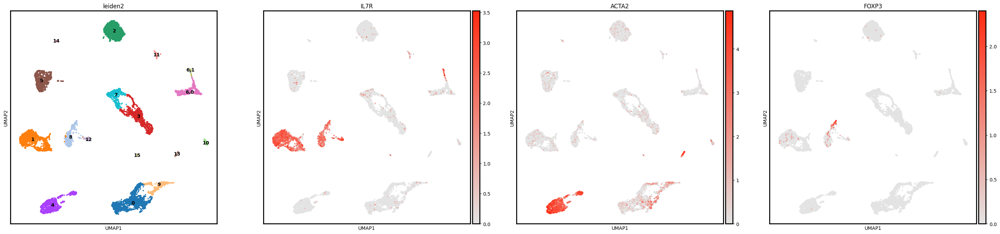

In [103]:
plt.rcParams['figure.figsize'] = [8,8]
sc.tl.leiden(adata, restrict_to = ('leiden', ['6']), resolution = 0.05, key_added= 'leiden2')
sc.pl.umap(adata, color=['leiden2','IL7R','ACTA2','FOXP3'], size = 30, legend_loc = 'on data', cmap = my_cmap)
#go back to the DE section to make sure this subcluster make sense

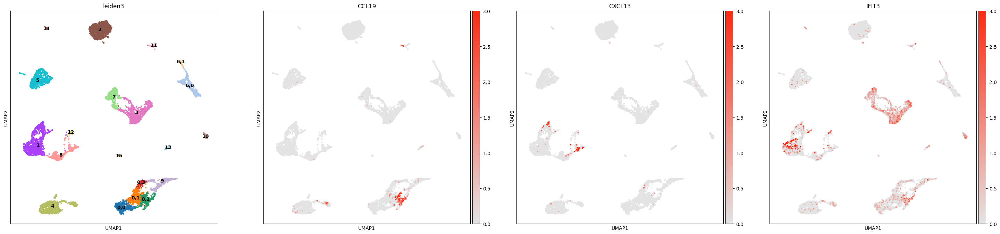

In [10]:
plt.rcParams['figure.figsize'] = [8,8]
sc.tl.leiden(adata, restrict_to = ('leiden2', ['0']), resolution = 0.25, key_added= 'leiden3')
sc.pl.umap(adata, color=['leiden3','CCL19','CXCL13','IFIT3'], size = 30, legend_loc = 'on data', cmap = my_cmap,vmax = 3)
#go back to the DE section to make sure this subcluster make sense

In [61]:
sc.tl.rank_genes_groups(adata, groupby='leiden2', key_added='rank2',method = 'wilcoxon')

ranking genes
    finished: added to `.uns['rank2']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:37)


In [147]:
[pass_genes_up, pass_genes_down] = DE_to_df(adata, rank_key='rank2', _padj_thresh = 0.01, _logfc_thresh = 2)

In [148]:
pass_genes_up['6,1'].dropna().tolist()

['KIT',
 'AL136456.1',
 'KRT86',
 'LIF',
 'LINC00299',
 'IL23R',
 'MMP9',
 'C1orf141',
 'KLRC1',
 'IL4I1',
 'SPINK2',
 'LST1',
 'CXCL8',
 'MYB',
 'TRBC1',
 'TYROBP',
 'ALDOC',
 'TIAM1',
 'FCER1G',
 'AC244502.1',
 'TMIGD2',
 'JAML',
 'ATP8B4',
 'GNLY',
 'NLRP3',
 'TXK',
 'LINC01814',
 'SMAP1',
 'LTB',
 'AREG',
 'KIAA1324',
 'AFF3',
 'GRAMD1B',
 'GDE1',
 'GNA15',
 'IL7R',
 'MACC1',
 'CA2',
 'XCL1',
 'LINC02384',
 'PRMT9',
 'AQP3',
 'AHR',
 'TEX30',
 'RGS1',
 'NINJ1',
 'GPR65',
 'IKZF2',
 'MPZL3',
 'SLC16A3',
 'BTBD11',
 'TIPARP',
 'WHRN',
 'PCDH9',
 'TNFRSF25',
 'SVIL',
 'RIN3',
 'MAST4',
 'GRAMD2B',
 'AC073332.1',
 'TNF',
 'RHOF',
 'FYCO1',
 'PTPN7',
 'TOX2',
 'PDE4A',
 'KLRB1',
 'BCL2A1',
 'LPXN',
 'ARHGAP10',
 'TNFRSF18',
 'HOTAIRM1',
 'PLXNC1',
 'AHRR',
 'WDFY2',
 'SLA',
 'CRADD',
 'BIN2',
 'TEC',
 'CEP83',
 'EPG5',
 'STK17B',
 'PTPN22',
 'STK26',
 'FURIN',
 'BRD1',
 'TNS3',
 'ANKRD28',
 'SRGN',
 'ZCCHC2',
 'IL18R1',
 'FES',
 'IL2RA',
 'JMY',
 'ITGB7',
 'NRIP1',
 'CASP3',
 'NCOA7',
 

In [64]:
sc.tl.rank_genes_groups(adata, groupby='leiden2',groups = ['3','7','14'], key_added='rankendo',method = 'wilcoxon')

ranking genes
    finished: added to `.uns['rankendo']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:32)


In [86]:
[pass_genes_up, pass_genes_down] = DE_to_df(adata, rank_key='rankendo', _padj_thresh = 0.01, _logfc_thresh = 2)

In [89]:
pass_genes_up.dropna()['7'].tolist()[0:30]

['ACKR1',
 'CCL23',
 'SELE',
 'CCL14',
 'RAB3C',
 'LHX6',
 'SELP',
 'TLL1',
 'CADM3-AS1',
 'MADCAM1',
 'FAM155A',
 'KLK10',
 'ZNF385D',
 'LINC02147',
 'ADGRG6',
 'LINC01013',
 'PLA1A',
 'C2CD4B',
 'LINC02208',
 'MEOX1',
 'CORT',
 'MMRN1',
 'FRMPD4',
 'CYTL1',
 'CYP1A1',
 'AL355612.1',
 'CLDN5',
 'APLNR',
 'TACSTD2',
 'RAMP3']

In [68]:
sc.tl.rank_genes_groups(adata, groupby='leiden2',groups = ['4','13'], key_added='ranksmooth',method = 'wilcoxon')

ranking genes
    finished: added to `.uns['ranksmooth']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:30)


In [69]:
[pass_genes_up, pass_genes_down] = DE_to_df(adata, rank_key='ranksmooth', _padj_thresh = 0.01, _logfc_thresh = 2)

In [77]:
pass_genes_up.dropna().iloc[0:30,:]

,4,13
0,KCNA5,SOSTDC1
1,MUSTN1,HSD17B6
2,C14orf180,DIO2
3,RERGL,HHIP
4,COX4I2,SYT10
5,FHL5,HHIP-AS1
6,ITIH3,LINC00578
7,KCNAB1,ACTG2
8,OR51E1,P2RY14
9,SUSD5,TAGLN


In [ ]:
adata.obs['celltype_lowres'] = adata.obs['leiden3']
adata.obs = adata.obs.replace({'celltype_lowres' : { '0,0': 'Fibroblast',
                                                    '0,1': 'Fibroblast',
                                                    '0,2': 'Fibroblastic Reticular Cells',
                                                    '0,3': 'Fibroblast',
                                                  '1':'T Cells',
                                                  '2':'B Cells',
                                                  '3':'MAdCAM1- Endothelial Cells',
                                                  '4':'Vascular Smooth Muscle Cells',
                                                  '5':'Intestinal Epithelial Cells',
                                                  '6,0':'Plasma Cells',
                                                  '6,1':'ILC3',
                                                  '7':'MAdCAM1+ Endothelial Cells',
                                                  '8':'T Cells',
                                                  '9':'Telocytes',
                                                  '10':'Enteric Glial Cells',
                                                  '11':'Mononuclear Phagocytes',
                                                  '12':'T Cells',
                                                  '13':'Muscularis Smooth Muscle Cells',
                                                  '14':'Lymphatic Endothelial Cells',
                                                  '15':'Tuft Cells'}})

In [ ]:
#plt.close()
plt.rcParams['axes.linewidth'] = 2
fig = sc.pl.umap(adata, color = ['celltype_lowres'],
                 size = 40, palette  = my_palette, ncols = 4, cmap = my_cmap, return_fig = True, legend_fontsize = 'large')
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
#plt.savefig('overall_map_withunmatched.png')

### IEC

In [50]:
subclustering = adata[adata.obs['celltype_lowres'].isin(['Intestinal Epithelial Cells']),:]

In [51]:
del subclustering.uns

In [53]:
subclustering =subclustering[:,~np.isnan(subclustering.X.A).any(axis=0)]

In [54]:
sc.pp.neighbors(subclustering, n_neighbors = 15, n_pcs = 50)
sc.tl.leiden(subclustering, resolution = 0.5, key_added= 'leiden')                                                 

In [55]:
sc.tl.tsne(subclustering)

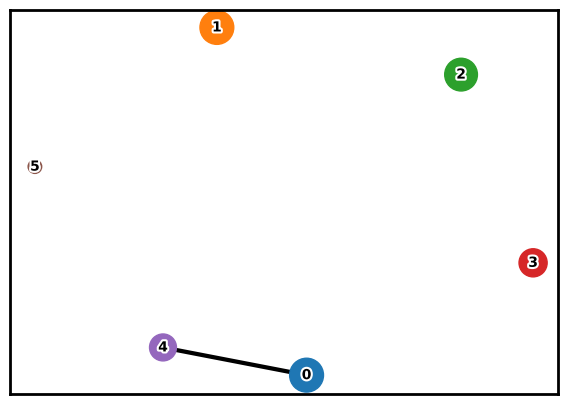

In [60]:
sc.tl.paga(subclustering, groups='leiden')
sc.pl.paga(subclustering,threshold = 0.4, labels=None, fontsize = 10, fontoutline = 3,node_size_scale = 3,node_size_power = 1,random_state = 0)
sc.tl.umap(subclustering, min_dist = 0.001, spread = 1.5,init_pos = 'paga')

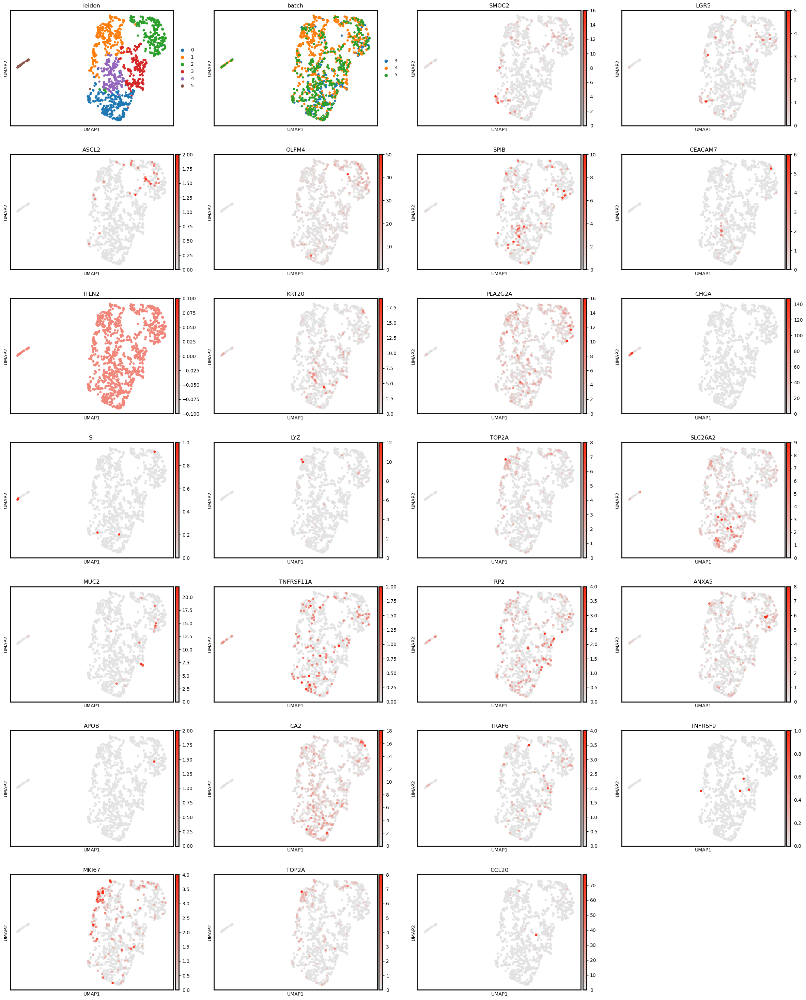

In [77]:
sc.pl.umap(subclustering, color = ['leiden','batch','SMOC2','LGR5','ASCL2','OLFM4','SPIB','CEACAM7','ITLN2','KRT20','PLA2G2A','CHGA',
                                               'SI','LYZ','TOP2A','SLC26A2','MUC2','TNFRSF11A','RP2','ANXA5','APOB','CA2','TRAF6','TNFRSF9','MKI67','TOP2A','CCL20'],cmap = my_cmap)

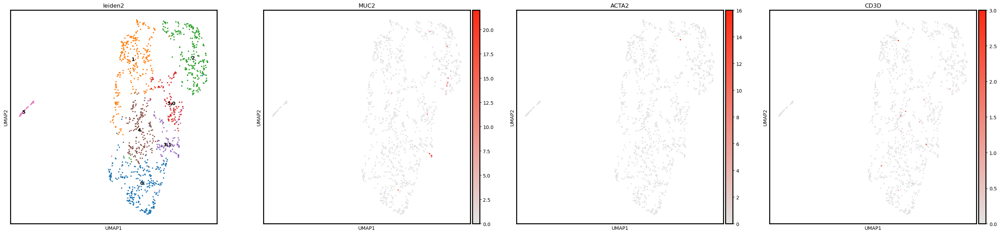

In [87]:
plt.rcParams['figure.figsize'] = [8,8]
sc.tl.leiden(subclustering, restrict_to = ('leiden', ['3']), resolution = 0.3, key_added= 'leiden2')
sc.pl.umap(subclustering, color=['leiden2','MUC2','ACTA2','CD3D'], size = 30, legend_loc = 'on data', cmap = my_cmap)
#go back to the DE section to make sure this subcluster make sense

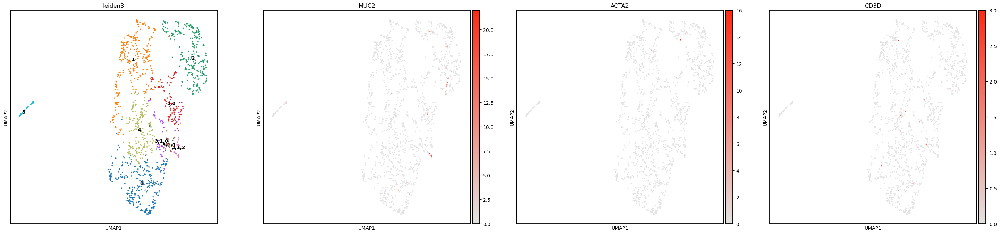

In [117]:
plt.rcParams['figure.figsize'] = [8,8]
sc.tl.leiden(subclustering, restrict_to = ('leiden2', ['3,1']), resolution = 0.3, key_added= 'leiden3')
sc.pl.umap(subclustering, color=['leiden3','MUC2','ACTA2','CD3D'], size = 30, legend_loc = 'on data', cmap = my_cmap)
#go back to the DE section to make sure this subcluster make sense

In [91]:
subclustering.obs['celltype_highres'] = subclustering.obs['leiden']
subclustering.obs = subclustering.obs.replace({'celltype_highres' : { '0': 'Colonocytes',
                                                  '1':'Transit Amplifying Cells',
                                                  '2':'Intestinal Stem Cells',
                                                  '3':'Unknown',
                                                  '4':'SPIB+ Colonocytes',
                                                  '5':'Enteroendocrine Cells'}})

### DE

In [93]:
def DE_to_df(_adata, rank_key, _padj_thresh=0.05, _logfc_thresh=1):
    def process_genes(i, direction):
        _log2foldmask = (_adata.uns[rank_key]['logfoldchanges'][i].astype('double') >= _logfc_thresh) if direction == "up" else (_adata.uns[rank_key]['logfoldchanges'][i].astype('double') <= -_logfc_thresh)
        _pvalmask = _adata.uns[rank_key]['pvals_adj'][i].astype('double') <= _padj_thresh
        _additional = pd.DataFrame({
            i: _adata.uns[rank_key]['names'][i].astype('str')[_log2foldmask & _pvalmask],
            'logfoldchanges_'+i: np.abs(_adata.uns[rank_key]['logfoldchanges'][i].astype('double')[_log2foldmask & _pvalmask])
        })
        _ribo_gene_mask = [gene.startswith('RPL') or gene.startswith('RPS') for gene in _additional[i]]
        _mt_gene_mask = [gene.startswith('MT-') for gene in _additional[i]]
        if len(_ribo_gene_mask)>0 and len(_mt_gene_mask)>0:
            _drop_id = np.array(np.array(_ribo_gene_mask) | np.array(_mt_gene_mask))
            _additional = _additional.sort_values(by='logfoldchanges_'+i, ascending=False)
            _additional = _additional.iloc[_drop_id==False, :].reset_index(drop=True)
        return _additional

    _pass_genes_up = pd.DataFrame()
    _pass_genes_down = pd.DataFrame()

    for i in set(_adata.uns[rank_key]['pvals_adj'].dtype.names):

        _pass_genes_up = pd.concat([_pass_genes_up, process_genes(i, "up")[i]], ignore_index=False, axis=1)
        _pass_genes_down = pd.concat([_pass_genes_down, process_genes(i, "down")[i]], ignore_index=False, axis=1)

        
    return _pass_genes_up, _pass_genes_down

In [95]:
sc.tl.rank_genes_groups(subclustering, groupby='celltype_highres', key_added='rank',method = 'wilcoxon')

In [97]:
[pass_genes_up, pass_genes_down] = DE_to_df(subclustering, rank_key='rank', _padj_thresh = 0.05, _logfc_thresh = 1.5)

In [101]:
print_full(pass_genes_up[''])

    SPIB+ Colonocytes Colonocytes Enteroendocrine Cells  \
0           MTRNR2L12      MALAT1                   PYY   
1              MT-CO2         JUN              HSP90AA1   
2             MT-ND4L        ELF3                   GCG   
3              MT-ND3        PCK1                   FEV   
4               ABCC3    HIST1H4C                 INSM1   
5                 NaN     GADD45B                 SMIM6   
6                 NaN        JUNB                  CHGA   
7                 NaN       DMBT1                HSPA1A   
8                 NaN    NAALADL2                 ACTG1   
9                 NaN       RSRP1                 HSPA5   
10                NaN        SOX4              HSP90AB1   
11                NaN    ADAMTSL1                HSPA1B   
12                NaN       NEAT1                   PAM   
13                NaN        BTG1                  SCG5   
14                NaN        IER2                  PRPH   
15                NaN       SATB2                   UBC 

### Take those interesting population out and sub-devide them

In [103]:
adata_IEC = adata[adata.obs['celltype_lowres'] == 'Intestinal Epithelial Cells',:]
adata_IEC.X = adata_IEC.layers['counts']
#adata_mono = adata[adata.obs['celltype_lowres'] == 'Mononuclear Phagocytes',:]
#adata_mono.X = adata_mono.layers['counts']
#adata_T = adata[adata.obs['celltype_lowres'] == 'T Cells',:]
#adata_T.X = adata_T.layers['counts']
#adata_B = adata[adata.obs['celltype_lowres'] == 'B Cells',:]
#adata_B.X = adata_B.layers['counts']

#### IEC

In [104]:
colnames = adata_IEC.obs_names
rownames = adata_IEC.var_names
batch = adata_IEC.obs['batch']
counts = adata_IEC.X.T

In [110]:
%%R -i counts -i colnames -i rownames -i batch
colnames(counts) = colnames
rownames(counts) = rownames

srat <- CreateSeuratObject(counts = counts, project = "IEC", min.cells = 0, min.features = 0, assay = "RNA")
srat[["batch"]] = batch
srat = SCTransform(object = srat, verbose = FALSE, vst.flavor = "v2", vars.to.regress = c("batch"),min_cells=0)
srat = RunPCA(srat, verbose = FALSE)

In [111]:
%%R -o HVG -o varExplained -o PCs -o mat -o left_genes -o X_pca

HVG = VariableFeatures(srat, assay = "SCT")

mat <- Seurat::GetAssayData(object = srat, slot = 'scale.data')
pca <- srat[["pca"]]
X_pca = pca@cell.embeddings
# Get the total variance:
total_variance <- sum(matrixStats::rowVars(mat))

eigValues = (pca@stdev)^2  ## EigenValues
varExplained = eigValues / total_variance

PCs = Loadings(srat, reduction = "pca")
left_genes = rownames(x = srat[["SCT"]])

saveRDS(srat,'F:/Tcell_tissues/srat_IEC.rds')

In [112]:
%%R -o counts -o logcounts -o residuals

counts = srat[["SCT"]]@counts
logcounts = srat[["SCT"]]@data
residuals = srat[["SCT"]]@scale.data

In [113]:
import anndata
adata_IEC_processed = anndata.AnnData(X = logcounts.T)
adata_IEC_processed.var_names = left_genes
adata_IEC_processed.obs_names = adata_IEC.obs_names
adata_IEC_processed.obs = adata_IEC.obs
adata_IEC_processed.uns['scaled'] = mat.T
adata_IEC_processed.layers['counts'] = counts.T
adata_IEC_processed.uns['residuals'] = residuals.T
adata_IEC_processed.layers['logcounts'] = logcounts.T
adata_IEC_processed.obsm['X_pca'] = X_pca

In [114]:
adata_IEC_processed.obs['n_counts'] = adata_IEC_processed.layers['counts'].sum(1)
adata_IEC_processed.obs['n_genes'] = (adata_IEC_processed.layers['counts'] > 0).sum(1)
adata_IEC_processed.var['highly_variable'] = adata_IEC_processed.var_names.isin(HVG)
adata_IEC_processed.uns['HVG'] = HVG
adata_IEC_processed.uns['pca'] = dict({'variance_ratio': varExplained})

In [115]:
mt_gene_mask = [gene.startswith('MT-') for gene in adata_IEC_processed.var_names]
adata.obs['mt_frac'] = np.array(adata_IEC_processed.layers['counts'][:, mt_gene_mask].sum(1).ravel())[0]/adata_IEC_processed.obs['n_counts']

In [116]:
ribo_gene_mask = [gene.startswith('RPL') or gene.startswith('RPS') for gene in adata_IEC_processed.var_names]
adata.obs['ribo_frac'] = np.array(adata_IEC_processed.layers['counts'][:, ribo_gene_mask].sum(1).ravel())[0]/adata_IEC_processed.obs['n_counts']

In [117]:
sc.pp.neighbors(adata_IEC_processed, n_pcs = 50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:06)


running Leiden clustering
    finished: found 9 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


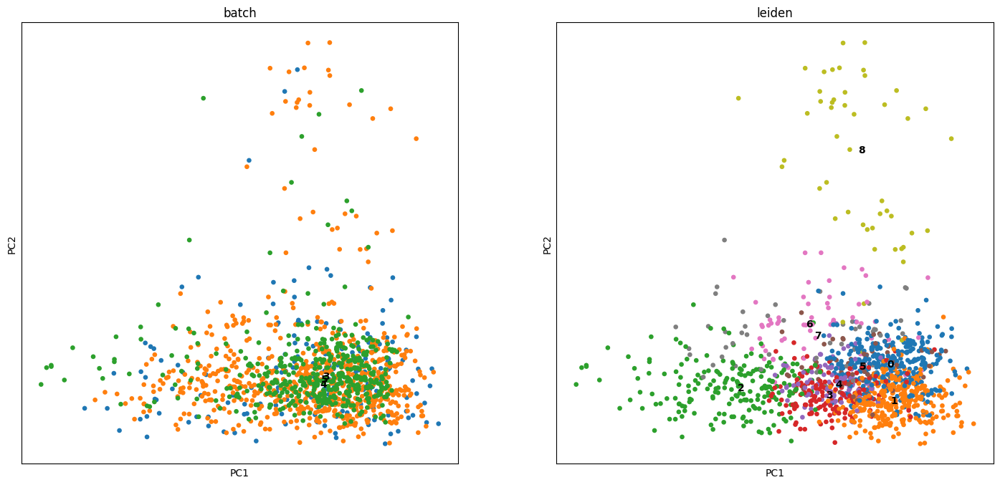

In [118]:
adata_IEC_processed = sc.tl.leiden(adata_IEC_processed, resolution = 0.8, key_added= 'leiden',copy  = True)
sc.pl.pca(adata_IEC_processed, color=['batch','leiden'], legend_loc = 'on data')

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


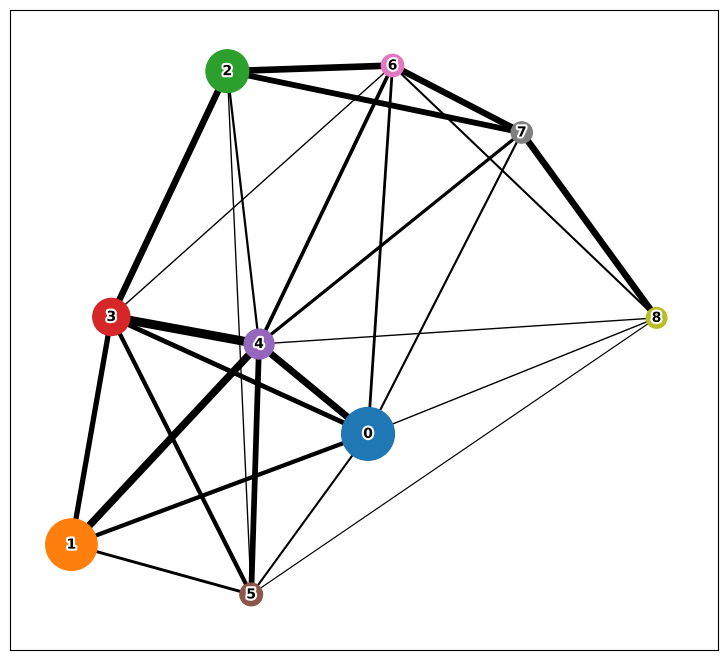

In [119]:
sc.tl.paga(adata_IEC_processed, groups='leiden')
sc.pl.paga(adata_IEC_processed,threshold = 0.1, labels=None, fontsize = 10, fontoutline = 3,node_size_scale = 3,node_size_power = 1,random_state = 0)

In [120]:
%matplotlib inline
sc.tl.umap(adata_IEC_processed, min_dist = 0.001, spread = 1.5,init_pos = 'paga')

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:02)


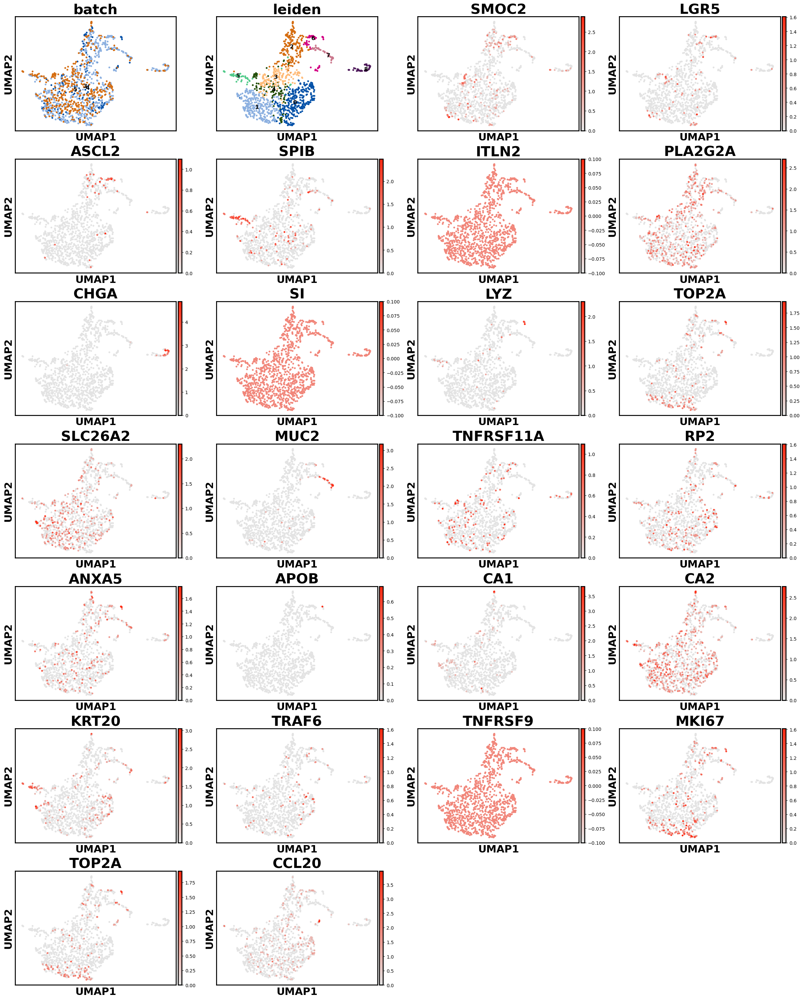

In [39]:
#plt.close()
plt.rcParams['axes.linewidth'] = 2
fig = sc.pl.umap(adata_IEC_processed, color = ['batch','leiden','SMOC2','LGR5','ASCL2','SPIB','ITLN2','PLA2G2A','CHGA',
                                               'SI','LYZ','TOP2A','SLC26A2','MUC2','TNFRSF11A','RP2','ANXA5','APOB','CA1','CA2','KRT20','TRAF6','TNFRSF9','MKI67','TOP2A','CCL20'],
                 size = 60, legend_loc = 'on data', palette  = my_palette, ncols = 4, cmap = my_cmap, return_fig = True, legend_fontsize = 'large')
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
#plt.savefig('overall_map_withunmatched.png')

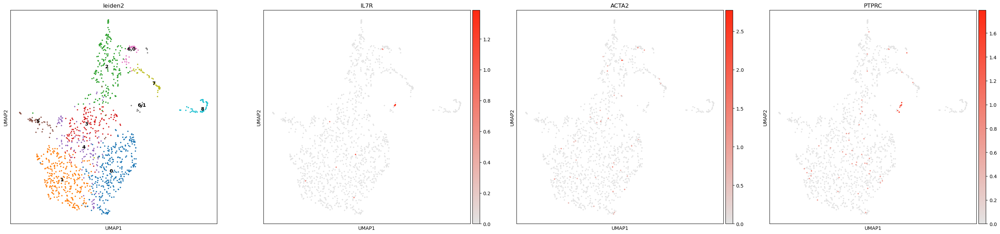

In [95]:
plt.rcParams['figure.figsize'] = [8,8]
sc.tl.leiden(adata_IEC_processed, restrict_to = ('leiden', ['6']), resolution = 0.2, key_added= 'leiden2')
sc.pl.umap(adata_IEC_processed, color=['leiden2','IL7R','ACTA2','PTPRC'], size = 30, legend_loc = 'on data', cmap = my_cmap)
#go back to the DE section to make sure this subcluster make sense

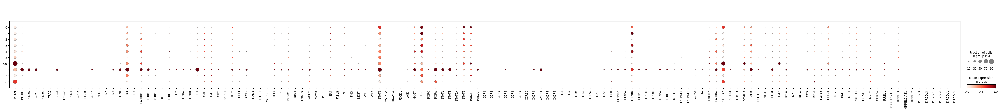

In [93]:
plt.rcParams.update({'font.size': 5, 'font.weight': 'heavy','axes.linewidth':5})
plt.rcParams.update(plt.rcParamsDefault)


sc.pl.dotplot(adata_IEC_processed,['EPCAM','PTPRC','CD3D','CD3E','CD3G','TRAC','TRBC1','TRGC2','CD4','CD8A','CD8B','CCR7', 'SELL',
                                 'CD27', 'CD28', 'IL7R', 'CD44','CD38','HLA-DRB1', 'KLRB1','KLRD1','KLRF1','KLRG1', 'IL2',
       'IL2RA', 'IL2RB', 'CD69', 'ITGAE', 'ITGA1','ITGB2','S1PR1','KLF2','CCL4','CCL5', 'GZMK', 'CD101', 'CX3CR1',
       'TCF7', 'LEF1', 'PRDM1', 'TBX21', 'EOMES', 'BACH2', 'GZMB', 'PRF1',
       'FAS', 'FASLG', 'TNF', 'IFNG', 'NKG7', 'XCL1',
       'XCL2', 'STAT3', 'CD40LG', 'TRAV1-2', 'PDCD1','LAG3',
       'MKI67', 'TFRC', 'RORC', 'RORA', 'STAT1', 'STAT4', 'STAT5A',
       'STAT6', 'RUNX1', 'RUNX3', 'CCR3', 'CCR4', 'CCR5', 'CCR6', 'CCR8','CCR9',
       'CCR10','CXCR3',  'CXCR4', 'CXCR5', 'CXCR6', 'IL4', 'IL5', 'IL10', 'IL13', 'IL17A',
       'IL21', 'IL22', 'IL6R', 'IL12RB2', 'IL15RA', 'IL17RB', 'IL18R1',
       'IL21R', 'IL23R', 'IL27RA', 'KLRD1', 'KLRK1','TNFRSF4', 'TNFRSF8', 'GZMA',
       'LTA', 'IFNGR2', 'HLA-DRA', 'SLC3A2', 'CTLA4', 'FOXP3', 'SMAD3',
       'AHR', 'ENTPD1', 'NT5E', 'TGFB1', 'ITGA2', 'BCL6', 'MAF', 'BTLA',
       'ICOS', 'DPP4', 'GATA3', 'CCL20', 'IRF4', 'BATF', 'TACR1',
       'ZBTB16', 'TNFSF8', 'IKZF2','FCGR3A','KIRREL1', 'KIRREL1-IT1', 'KIRREL3', 'KIRREL3-AS1', 'KIRREL2',
       'KIR3DL3', 'KIR2DL3', 'KIR2DL1', 'KIR2DL4', 'KIR3DL1', 'KIR3DL2'],groupby = 'leiden2' , vmax = 1, 
              swap_axes = False ,dot_min = 0,standard_scale = 'var')
# Checked IL9, nothing

In [232]:
sc.tl.rank_genes_groups(adata_IEC_processed, groupby='leiden2', key_added='rank',method = 'wilcoxon')

ranking genes
    finished: added to `.uns['rank']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:03)


In [247]:
[pass_genes_up, pass_genes_down] = DE_to_df(adata_IEC_processed, rank_key='rank', _padj_thresh = 0.05, _logfc_thresh = 1)

In [248]:
pass_genes_up['1'].dropna().tolist()

['IQCD',
 'HIST1H4B',
 'GPT',
 'TONSL',
 'LPCAT4',
 'NXPE4',
 'HIST1H2BF',
 'SLC26A2',
 'HSD11B2',
 'AC073050.1',
 'PCSK5',
 'ACSS2',
 'PIGZ',
 'TNFRSF14-AS1',
 'FAM120B',
 'PCK1',
 'AC025164.1',
 'AC011498.1',
 'RNPC3',
 'HIST1H2BL',
 'CDHR5',
 'HIST1H2BN',
 'LINC01843',
 'ABHD8',
 'GADD45G',
 'AZIN2',
 'PRRG2',
 'SHPRH',
 'SEMA5A',
 'PLCE1',
 'SLC4A4',
 'HIST1H2BG',
 'HIST1H4H',
 'ERICH1',
 'DNAJC11',
 'EYA2',
 'ABO',
 'ANKRD37',
 'AP001372.1',
 'NMRK1',
 'FABP1',
 'DOCK1',
 'PILRB',
 'HIST1H2BB',
 'RASL11A',
 'ABR',
 'NQO2',
 'SELENBP1',
 'EPHX2',
 'VPS13D',
 'TCIRG1',
 'CFTR',
 'HIST1H2AC',
 'LINC00278',
 'RABL6',
 'SOX4',
 'HDHD3',
 'NUAK2',
 'ATP10B',
 'MED29',
 'SATB2-AS1',
 'CCNL2',
 'MUC4',
 'MTG1',
 'AFMID',
 'MID1',
 'CDH17',
 'PRKN',
 'ERN2',
 'AP1G2',
 'CNTN4',
 'HIST1H2BD',
 'LIMK2',
 'PNKP',
 'XACT',
 'HIST1H2AG',
 'Z93241.1',
 'EPS8L2',
 'PRR3',
 'ABCC3',
 'TUBA1C',
 'PIBF1']

In [97]:
adata_IEC_processed.obs['celltype_highres'] = adata_IEC_processed.obs['leiden2']
adata_IEC_processed.obs = adata_IEC_processed.obs.replace({'celltype_highres' : { '0': 'Colonocytes',
                                                  '1':'Colonocytes',
                                                  '2':'Transit Amplifying Cells',
                                                  '3':'Colonocytes',
                                                  '4':'Colonocytes',
                                                  '5':'SPIB+ Cells',
                                                  '6,0':'Intestinal Stem Cells',
                                                  '6,1':'TCRab CD4 Mobile TRM',
                                                  '7':'Goblet Cells',
                                                  '8':'Enteroendocrine Cells'}})

In [99]:
adata_IEC_processed

AnnData object with n_obs × n_vars = 1319 × 29051
    obs: 'n_counts', 'log_counts', 'n_genes', 'log10GenesPerUMI', 'mt_frac', 'ribo_frac', 'batch', 'S_score', 'G2M_score', 'S_G2M_diff', 'phase', 'leiden', 'leiden2', 'leiden3', 'cluster_lowres', 'celltype_lowres', 'celltype_highres'
    var: 'highly_variable'
    uns: 'HVG', 'batch_colors', 'celltype_lowres_colors', 'leiden', 'leiden2_colors', 'leiden_colors', 'leiden_sizes', 'neighbors', 'paga', 'pca', 'residuals', 'scaled', 'umap', 'leiden2'
    obsm: 'X_pca', 'X_umap'
    layers: 'counts', 'logcounts'
    obsp: 'connectivities', 'distances'

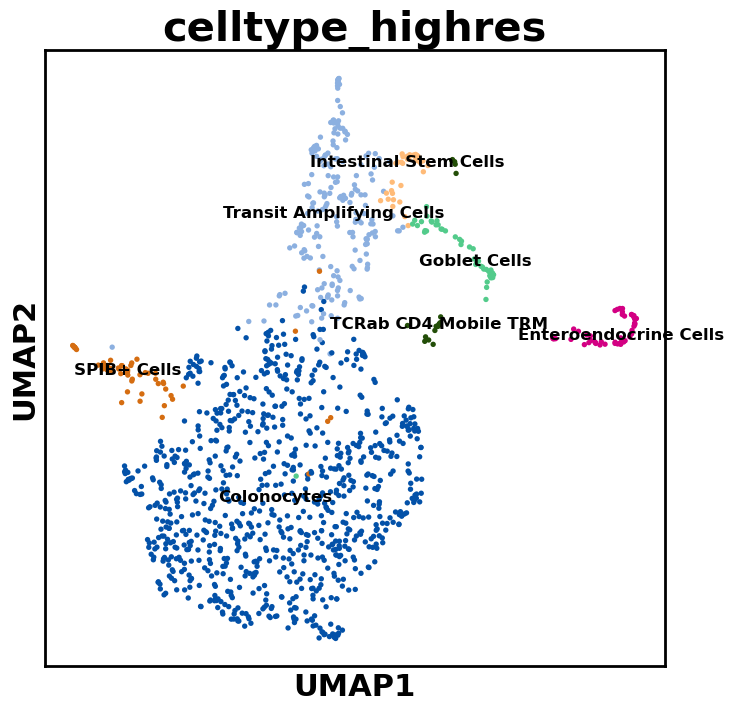

In [101]:
#plt.close()
%matplotlib inline
#adata_IEC_processed = adata_IEC_processed[adata_IEC_processed.obs['celltype_highres']!='TCRab CD4 TEM/TRM',:]
plt.rcParams['axes.linewidth'] = 2
fig = sc.pl.umap(adata_IEC_processed, color = ['celltype_highres'],
                 size = 60, legend_loc = 'on data', palette  = my_palette, ncols = 4, cmap = my_cmap, return_fig = True, legend_fontsize = 'large')
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
#plt.savefig('overall_map_withunmatched.png')

In [134]:
adata_IEC_processed.uns['HVG'] = list(adata_IEC_processed.uns['HVG'])

In [103]:
adata_IEC_processed.write_h5ad('IEC_annotated.h5ad')

In [91]:
adata_IEC_processed = sc.read_h5ad('IEC_annotated_0.h5ad')

#### Monos

In [266]:
colnames = adata_mono.obs_names
rownames = adata_mono.var_names
batch = adata_mono.obs['batch']
counts = adata_mono.X.T

In [267]:
%%R -i counts -i colnames -i rownames -i batch
colnames(counts) = colnames
rownames(counts) = rownames

srat <- CreateSeuratObject(counts = counts, project = "mono", min.cells = 0, min.features = 0, assay = "RNA")
srat[["batch"]] = batch
srat = SCTransform(object = srat, verbose = FALSE, vst.flavor = "v2", vars.to.regress = c("batch"),min_cells=0)
srat = RunPCA(srat, verbose = FALSE)

In [268]:
%%R -o HVG -o varExplained -o PCs -o mat -o left_genes -o X_pca

HVG = VariableFeatures(srat, assay = "SCT")

mat <- Seurat::GetAssayData(object = srat, slot = 'scale.data')
pca <- srat[["pca"]]
X_pca = pca@cell.embeddings
# Get the total variance:
total_variance <- sum(matrixStats::rowVars(mat))

eigValues = (pca@stdev)^2  ## EigenValues
varExplained = eigValues / total_variance

PCs = Loadings(srat, reduction = "pca")
left_genes = rownames(x = srat[["SCT"]])

saveRDS(srat,'F:/Tcell_tissues/srat_mono.rds')

In [269]:
%%R -o counts -o logcounts -o residuals

counts = srat[["SCT"]]@counts
logcounts = srat[["SCT"]]@data
residuals = srat[["SCT"]]@scale.data

In [270]:
adata_mono_processed = anndata.AnnData(X = logcounts.T)
adata_mono_processed.var_names = left_genes
adata_mono_processed.obs_names = adata_mono.obs_names
adata_mono_processed.obs = adata_mono.obs
adata_mono_processed.uns['scaled'] = mat.T
adata_mono_processed.layers['counts'] = counts.T
adata_mono_processed.uns['residuals'] = residuals.T
adata_mono_processed.layers['logcounts'] = logcounts.T
adata_mono_processed.obsm['X_pca'] = X_pca

In [271]:
adata_mono_processed.obs['n_counts'] = adata_mono_processed.layers['counts'].sum(1)
adata_mono_processed.obs['n_genes'] = (adata_mono_processed.layers['counts'] > 0).sum(1)
adata_mono_processed.var['highly_variable'] = adata_mono_processed.var_names.isin(HVG)
adata_mono_processed.uns['HVG'] = list(HVG)
adata_mono_processed.uns['pca'] = dict({'variance_ratio': varExplained})

In [272]:
mt_gene_mask = [gene.startswith('MT-') for gene in adata_mono_processed.var_names]
adata.obs['mt_frac'] = np.array(adata_mono_processed.layers['counts'][:, mt_gene_mask].sum(1).ravel())[0]/adata_mono_processed.obs['n_counts']

In [273]:
ribo_gene_mask = [gene.startswith('RPL') or gene.startswith('RPS') for gene in adata_mono_processed.var_names]
adata.obs['ribo_frac'] = np.array(adata_mono_processed.layers['counts'][:, ribo_gene_mask].sum(1).ravel())[0]/adata_mono_processed.obs['n_counts']

In [274]:
sc.pp.neighbors(adata_mono_processed, n_pcs = 50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


running Leiden clustering
    finished: found 4 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


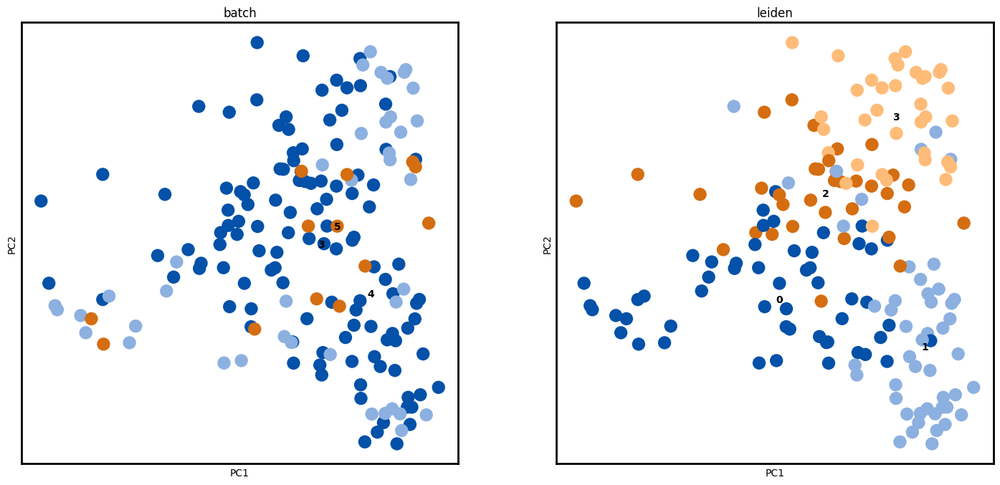

In [319]:
adata_mono_processed = sc.tl.leiden(adata_mono_processed, resolution = 0.8, key_added= 'leiden',copy  = True)
sc.pl.pca(adata_mono_processed, color=['batch','leiden'], legend_loc = 'on data')

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


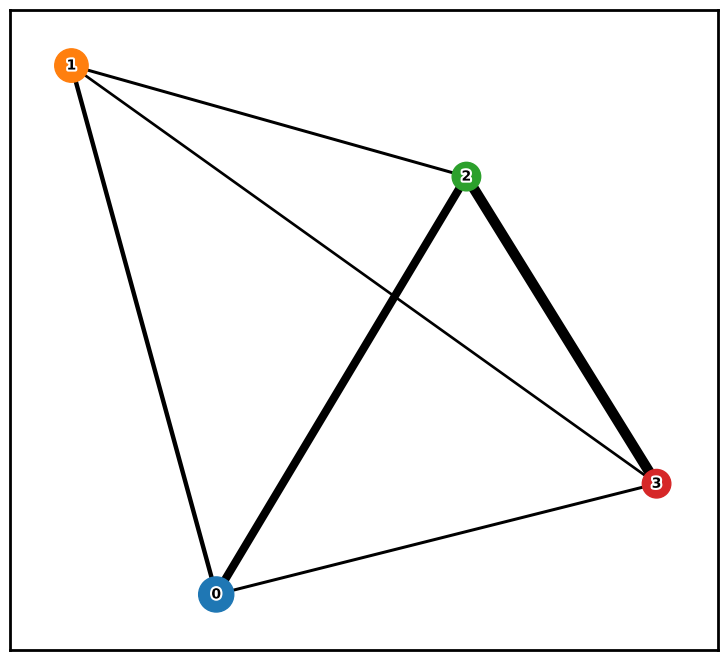

In [320]:
sc.tl.paga(adata_mono_processed, groups='leiden')
sc.pl.paga(adata_mono_processed,threshold = 0.2, labels=None, fontsize = 10, fontoutline = 3,node_size_scale = 3,node_size_power = 1,random_state = 0)

In [321]:
%matplotlib inline
sc.tl.umap(adata_mono_processed, min_dist = 0.001, spread = 1.5,init_pos = 'paga')

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:00)


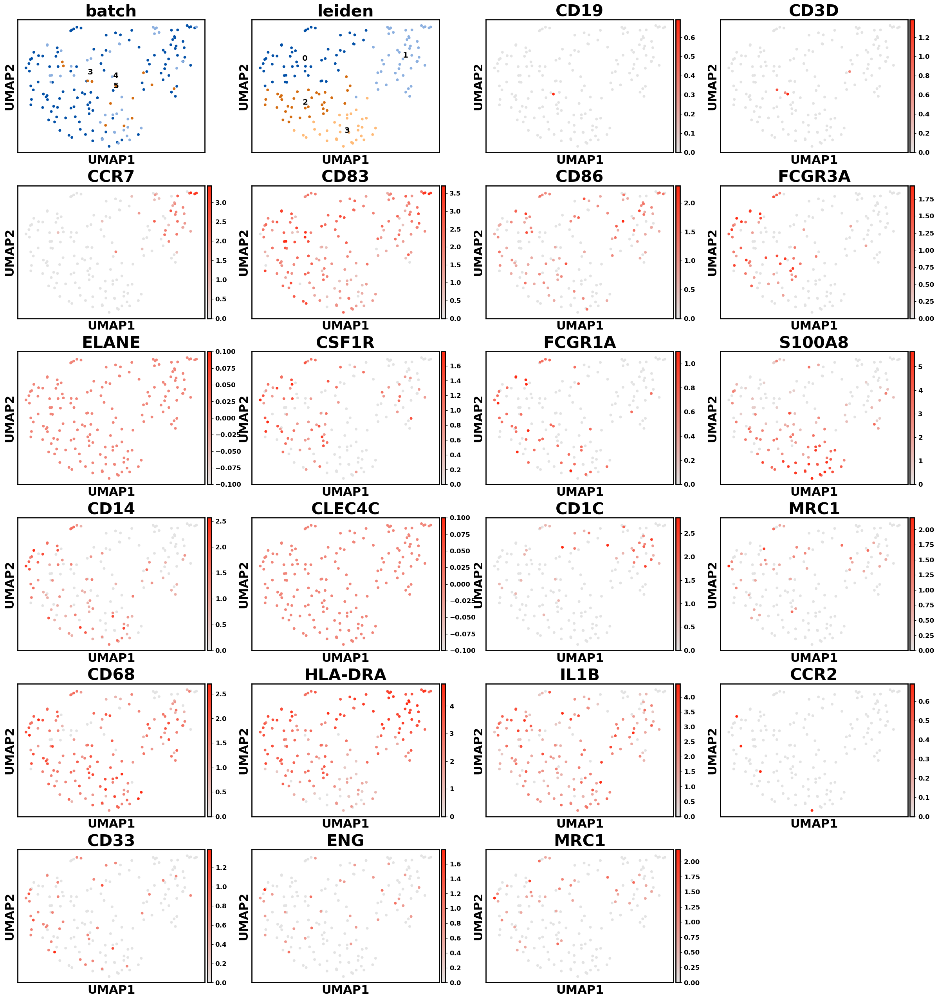

In [59]:
#plt.close()
%matplotlib inline
plt.rcParams['axes.linewidth'] = 2
fig = sc.pl.umap(adata_mono_processed, color = ['batch','leiden','CD19','CD3D','CCR7','CD83','CD86',
                                                'FCGR3A','ELANE','CSF1R','FCGR1A','S100A8','CD14',
                                               'CLEC4C','CD1C','MRC1','CD68','HLA-DRA','IL1B','CCR2','CD33','ENG','MRC1'],
                                                size = 100, legend_loc = 'on data', palette  = my_palette, ncols = 4, cmap = my_cmap, return_fig = True, legend_fontsize = 'large')
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
#plt.savefig('overall_map_withunmatched.png')

In [331]:
sc.tl.rank_genes_groups(adata_mono_processed, groupby='leiden2', key_added='rank',method = 'wilcoxon')

ranking genes
    finished: added to `.uns['rank']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


In [332]:
[pass_genes_up, pass_genes_down] = DE_to_df(adata_mono_processed, rank_key='rank', _padj_thresh = 0.05, _logfc_thresh = 1)

In [333]:
pass_genes_up['0,0'].dropna().tolist()

['SELENOP',
 'CPED1',
 'P4HA1',
 'LGMN',
 'HES1',
 'EGR1',
 'JUN',
 'ATF3',
 'ATF6',
 'PLEKHG2',
 'SEMA4A',
 'FOS',
 'DNAJA4',
 'CNOT2',
 'JUNB',
 'IER3',
 'FOSB',
 'IER5',
 'ARIH1',
 'TANK',
 'NR4A2',
 'ZFP36',
 'IFRD1',
 'NR4A1',
 'IER2',
 'BAG3',
 'NUFIP2',
 'HSPH1',
 'QKI',
 'CCNL1',
 'CLK1',
 'BAZ1A',
 'HERPUD1',
 'HSPA1B',
 'JUND',
 'RAB7A',
 'DNAJB6',
 'CD83',
 'NFE2L2',
 'DNAJA1',
 'MT-ND2',
 'RASGEF1B',
 'MT-CYB',
 'MT-ATP6']

In [54]:
adata_mono_processed.obs['celltype_highres'] = adata_mono_processed.obs['leiden']
adata_mono_processed.obs = adata_mono_processed.obs.replace({'celltype_highres' : { '0': 'M2-like CD16+ Macrophages',
                                                  '1':'cDC2',
                                                  '2':'M2-like CD16+ Macrophages',
                                                  '3':'CD16- Conventional Monocytes'}})

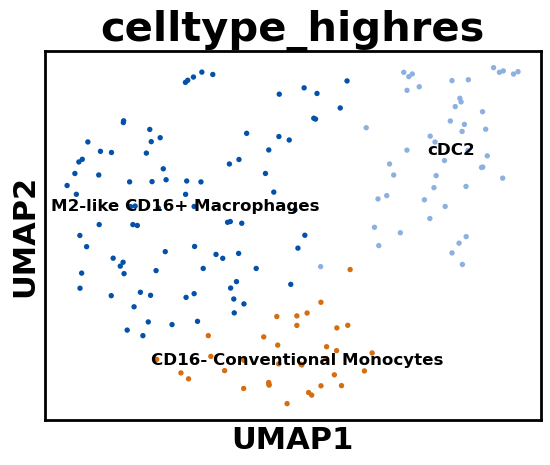

In [56]:
#plt.close()
adata_mono_processed = adata_mono_processed[adata_mono_processed.obs['celltype_highres']!='T Cells',:]
plt.rcParams['axes.linewidth'] = 2
fig = sc.pl.umap(adata_mono_processed, color = ['celltype_highres'],
                 size = 60, legend_loc = 'on data', palette  = my_palette, ncols = 4, cmap = my_cmap, return_fig = True, legend_fontsize = 'large')
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
#plt.savefig('overall_map_withunmatched.png')

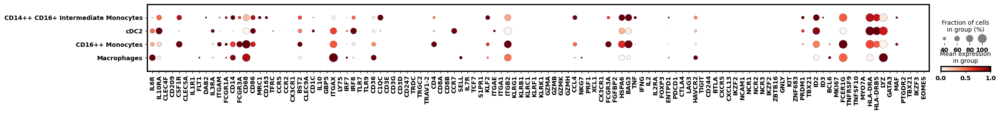

In [57]:
plt.rcParams.update({'font.size': 12, 'font.weight': 'heavy','axes.linewidth':2})
#plt.rcParams.update(plt.rcParamsDefault)

gene_list = ['IL6R','IL10RA','CLEC4F','CD209','CSF1R','CLEC5A','IL1R1','FLT1','DAB2','IL3RA','ITGAM','FCGR1A','CD14','FCGR3A','CD68','CD86','MRC1','CD163',
             'TFRC','CCR5','CCR2','CX3CR1','BST2','CLEC9A','CD1C','IL10','GBP5','ITGAX','LY75','IRF7','IRF8','TLR7','TLR9',
             'CD36','C1QC','CD3E','CD3G','CD3D','CD247','TRDC','TRGC2','TRAV1-2','CD4','CD8A','CD8B','CCR7','SELL','IL7R','TCF7','S1PR1','KLF2',
                    'ITGAE','ITGA1','ITGB2','KLRG1','KLRB1','KLRC1','KLRF1','KLRK1','GZMA','GZMB','GZMK','GZMH','CCL4','NKG7','PRF1',
                         'XCL1','CX3CR1','FCGR3A','FGFBP2','HSPA6','BAG3','TNF','IFNG','IL2','IL2RA','FOXP3','ENTPD1','PDCD1','CTLA4','LAG3','HAVCR2','TIGIT',
             'CD244','BTLA','CXCR5','CXCL13','IKZF2','NCAM1','NCR1','NCR2','NCR3','IKZF2','ZBTB16',
             'GNLY','KIT','ZNF683','PRDM1','TBX21','ID2','ID3','BCL6','MKI67','FCER1G','TNFRSF9','TNFSF10','MYO7A','HLA-DRA','HLA-DRB5','LYZ','GATA3','MAF','PTGDR2','TBX21','IKZF3','EOMES']
sc.pl.dotplot(adata_mono_processed,gene_list,groupby = 'celltype_lowres' , vmax = 1, 
              swap_axes = False ,dot_min = 0.2,standard_scale = 'var',figsize = (25,2))

In [348]:
adata_mono_processed.uns['HVG'] = list(adata_mono_processed.uns['HVG'])

In [63]:
adata_mono_processed.write_h5ad('mono_annotated.h5ad')

In [9]:
adata_mono_processed = sc.read_h5ad('mono_annotated.h5ad')

#### Bs

In [14]:
colnames = adata_B.obs_names
rownames = adata_B.var_names
batch = adata_B.obs['batch']
counts = adata_B.X.T

In [15]:
%%R -i counts -i colnames -i rownames -i batch
colnames(counts) = colnames
rownames(counts) = rownames

srat <- CreateSeuratObject(counts = counts, project = "B", min.cells = 0, min.features = 0, assay = "RNA")
srat[["batch"]] = batch
srat = SCTransform(object = srat, verbose = FALSE, vst.flavor = "v2", vars.to.regress = c("batch"),min_cells=0)
srat = RunPCA(srat, verbose = FALSE)

In [16]:
%%R -o HVG -o varExplained -o PCs -o mat -o left_genes -o X_pca

HVG = VariableFeatures(srat, assay = "SCT")

mat <- Seurat::GetAssayData(object = srat, slot = 'scale.data')
pca <- srat[["pca"]]
X_pca = pca@cell.embeddings
# Get the total variance:
total_variance <- sum(matrixStats::rowVars(mat))

eigValues = (pca@stdev)^2  ## EigenValues
varExplained = eigValues / total_variance

PCs = Loadings(srat, reduction = "pca")
left_genes = rownames(x = srat[["SCT"]])

saveRDS(srat,'F:/Tcell_tissues/srat_B.rds')

In [17]:
%%R -o counts -o logcounts -o residuals

counts = srat[["SCT"]]@counts
logcounts = srat[["SCT"]]@data
residuals = srat[["SCT"]]@scale.data

In [20]:
import anndata
adata_B_processed = anndata.AnnData(X = logcounts.T)
adata_B_processed.var_names = left_genes
adata_B_processed.obs_names = adata_B.obs_names
adata_B_processed.obs = adata_B.obs
adata_B_processed.uns['scaled'] = mat.T
adata_B_processed.layers['counts'] = counts.T
adata_B_processed.uns['residuals'] = residuals.T
adata_B_processed.layers['logcounts'] = logcounts.T
adata_B_processed.obsm['X_pca'] = X_pca

In [21]:
adata_B_processed.obs['n_counts'] = adata_B_processed.layers['counts'].sum(1)
adata_B_processed.obs['n_genes'] = (adata_B_processed.layers['counts'] > 0).sum(1)
adata_B_processed.var['highly_variable'] = adata_B_processed.var_names.isin(HVG)
adata_B_processed.uns['HVG'] = list(HVG)
adata_B_processed.uns['pca'] = dict({'variance_ratio': varExplained})

In [22]:
mt_gene_mask = [gene.startswith('MT-') for gene in adata_B_processed.var_names]
adata.obs['mt_frac'] = np.array(adata_B_processed.layers['counts'][:, mt_gene_mask].sum(1).ravel())[0]/adata_B_processed.obs['n_counts']

In [23]:
ribo_gene_mask = [gene.startswith('RPL') or gene.startswith('RPS') for gene in adata_B_processed.var_names]
adata.obs['ribo_frac'] = np.array(adata_B_processed.layers['counts'][:, ribo_gene_mask].sum(1).ravel())[0]/adata_B_processed.obs['n_counts']

In [24]:
sc.pp.neighbors(adata_B_processed, n_pcs = 50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:06)


running Leiden clustering
    finished: found 5 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


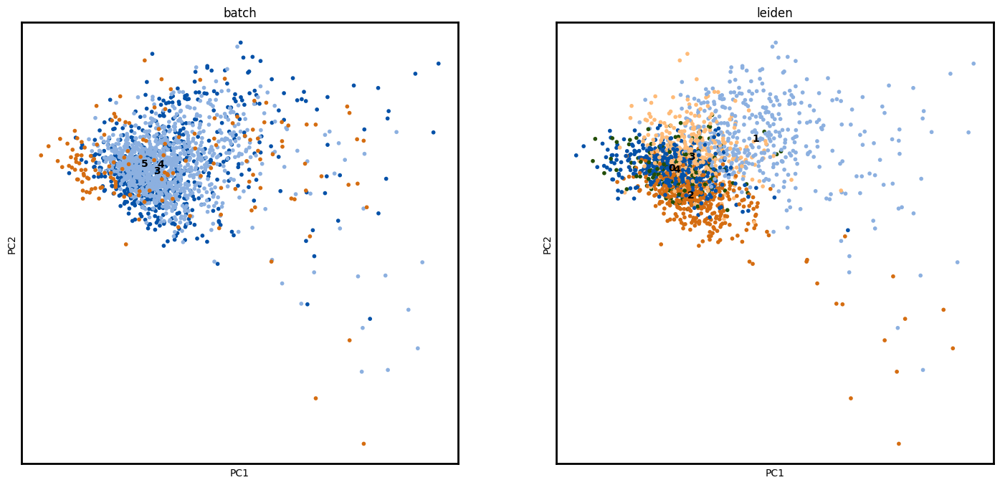

In [31]:
adata_B_processed = sc.tl.leiden(adata_B_processed, resolution = 0.5, key_added= 'leiden',copy  = True)
sc.pl.pca(adata_B_processed, color=['batch','leiden'], legend_loc = 'on data')

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


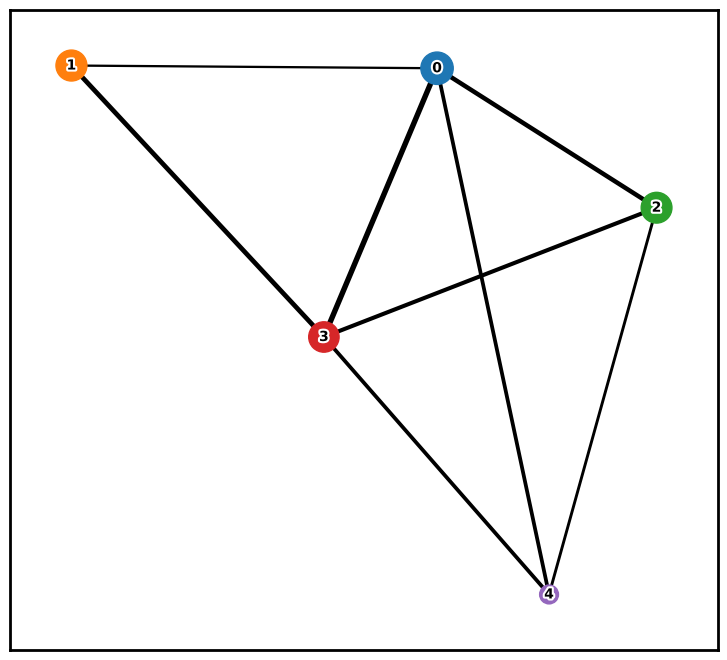

In [32]:
sc.tl.paga(adata_B_processed, groups='leiden')
sc.pl.paga(adata_B_processed,threshold = 0.2, labels=None, fontsize = 10, fontoutline = 3,node_size_scale = 3,node_size_power = 1,random_state = 0)

In [33]:
%matplotlib inline
sc.tl.umap(adata_B_processed, min_dist = 0.001, spread = 1.5,init_pos = 'paga')

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:03)


In [66]:
genemask = [gene.startswith('IGHV') for gene in adata_B_processed.var_names]
IGHV_genes = adata_B_processed.var_names[genemask]

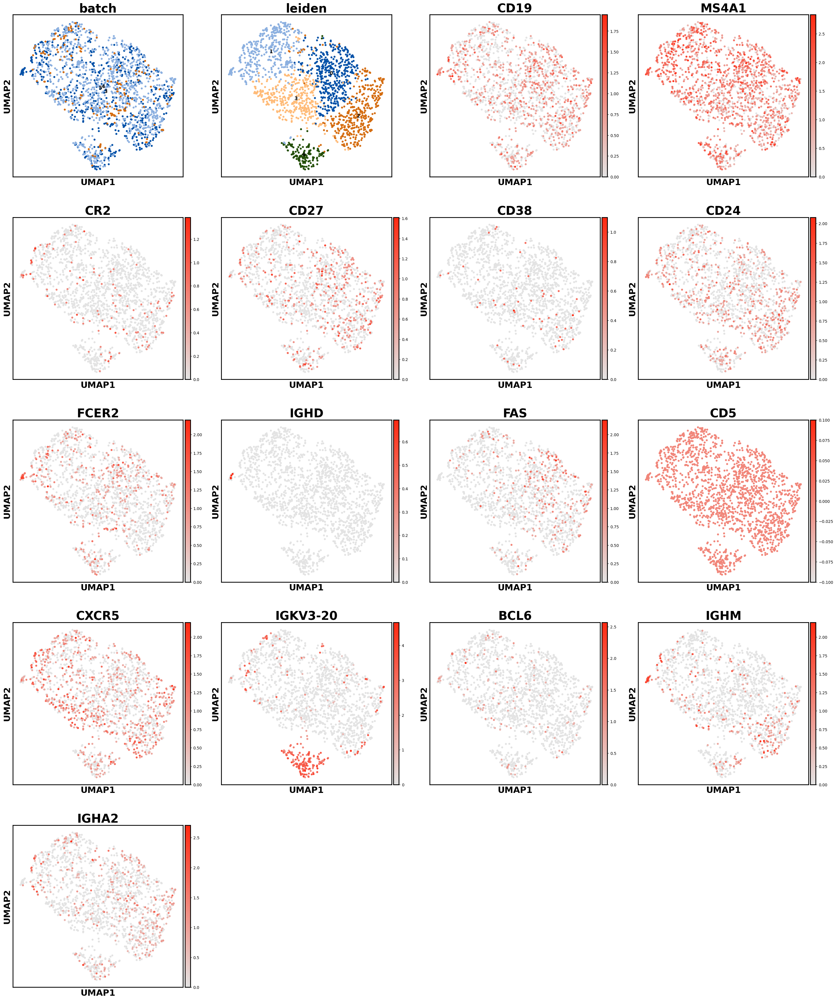

In [76]:
#plt.close()
plt.rcParams['axes.linewidth'] = 2
fig = sc.pl.umap(adata_B_processed, color = ['batch','leiden','CD19','MS4A1','CR2','CD27','CD38',
                                                'CD24','FCER2', 'IGHD','FAS','CD5','CXCR5','IGKV3-20','BCL6','IGHM','IGHA2'],
                                                size = 100, legend_loc = 'on data', palette  = my_palette, ncols = 4, cmap = my_cmap, return_fig = True, legend_fontsize = 'large')
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
#plt.savefig('overall_map_withunmatched.png')

running Leiden clustering
    finished: found 8 clusters and added
    'leiden2', the cluster labels (adata.obs, categorical) (0:00:00)


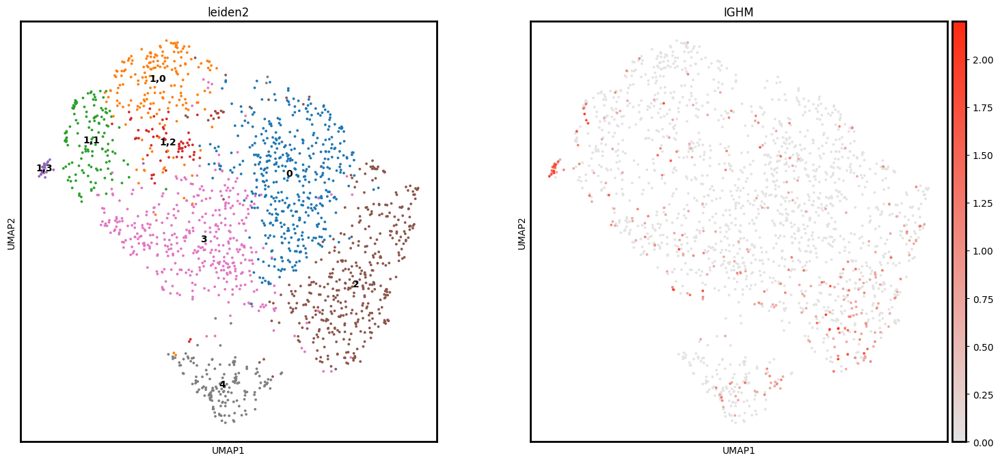

In [80]:
plt.rcParams['figure.figsize'] = [8,8]
sc.tl.leiden(adata_B_processed, restrict_to = ('leiden', ['1']), resolution = 0.4, key_added= 'leiden2')
sc.pl.umap(adata_B_processed, color=['leiden2','IGHM'], size = 30, legend_loc = 'on data', cmap = my_cmap)
#go back to the DE section to make sure this subcluster make sense

In [43]:
sc.tl.rank_genes_groups(adata_B_processed, groupby='leiden', key_added='rank',method = 'wilcoxon')

ranking genes
    finished: added to `.uns['rank']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:04)


In [53]:
[pass_genes_up, pass_genes_down] = DE_to_df(adata_B_processed, rank_key='rank', _padj_thresh = 0.05, _logfc_thresh = 2)

In [54]:
pass_genes_up['1'].dropna().tolist()

['HSPA1B',
 'HSPA6',
 'DNAJB1',
 'SREBF2-AS1',
 'ILF3-DT',
 'EGR1',
 'DNAJB4',
 'AL691403.1',
 'RGS1',
 'BAG3']

In [41]:
adata_B_processed.obs['celltype_highres'] = adata_B_processed.obs['leiden2']
adata_B_processed.obs = adata_B_processed.obs.replace({'celltype_highres' : { '0': 'Memory B Cells',
                                                  '1,0':'Memory B Cells',
                                                  '1,1':'Memory B Cells',
                                                  '1,2':'Memory B Cells',
                                                  '1,3':'Naive B Cells',
                                                  '2':'Memory B Cells',
                                                  '3':'Memory B Cells',
                                                  '4':'Memory B Cells'}})

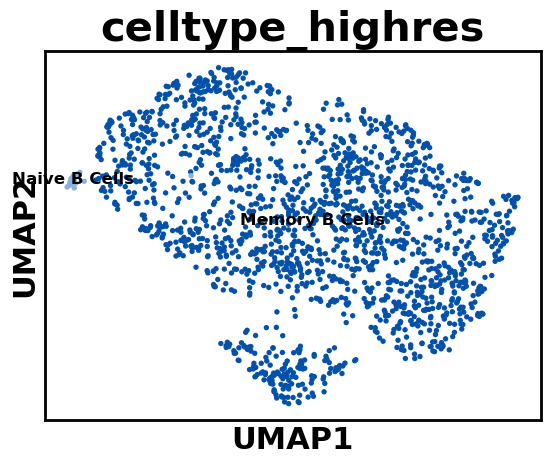

In [43]:
#plt.close()
plt.rcParams['axes.linewidth'] = 2
fig = sc.pl.umap(adata_B_processed, color = ['celltype_highres'],
                 size = 60, legend_loc = 'on data', palette  = my_palette, ncols = 4, cmap = my_cmap, return_fig = True, legend_fontsize = 'large')
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
#plt.savefig('overall_map_withunmatched.png')

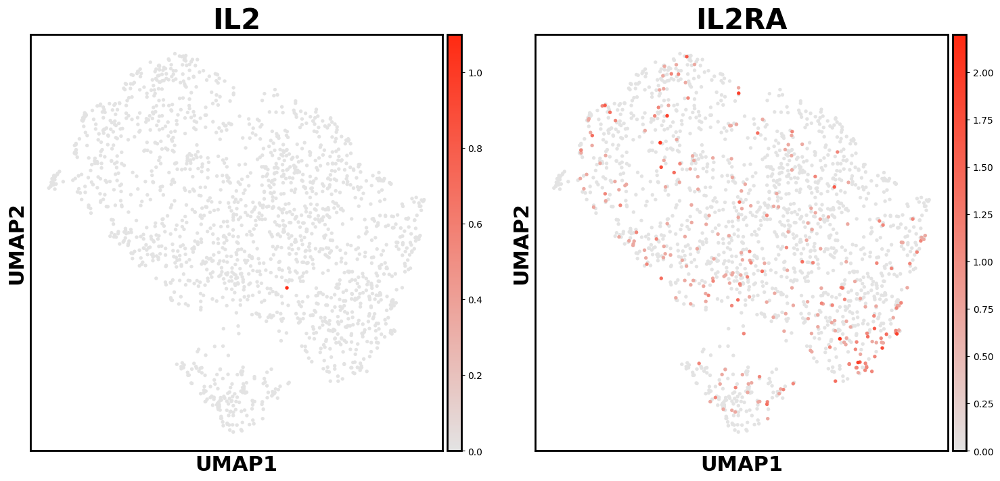

In [21]:
#plt.close()
plt.rcParams['axes.linewidth'] = 2
fig = sc.pl.umap(adata_B_processed, color = ['IL2','IL2RA'],
                 size = 60, legend_loc = 'on data', palette  = my_palette, ncols = 4, cmap = my_cmap, return_fig = True, legend_fontsize = 'large')
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
#plt.savefig('overall_map_withunmatched.png')

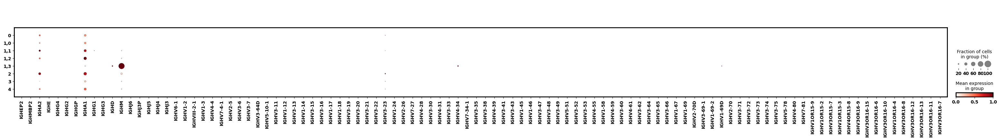

In [72]:
# plt.rcParams.update({'font.size': 15, 'font.weight': 'heavy','axes.linewidth':2})
#plt.rcParams.update(plt.rcParamsDefault)
gamma_genesmask = [gene.startswith("IGH") for gene in adata_B_processed.var_names]
gamma_genes = adata_B_processed.var_names[gamma_genesmask]

sc.pl.dotplot(adata_B_processed,gamma_genes,groupby = 'leiden2' , vmax = 1, swap_axes = False, dot_min =0.1, dot_max =1,standard_scale = 'var')

In [45]:
adata_B_processed.write_h5ad('B_annotated.h5ad')

In [67]:
adata_B_processed = sc.read_h5ad('B_annotated.h5ad')

#### T

In [86]:
colnames = adata_T.obs_names
rownames = adata_T.var_names
batch = adata_T.obs['batch']
counts = adata_T.X.T

In [87]:
%%R -i counts -i colnames -i rownames -i batch
colnames(counts) = colnames
rownames(counts) = rownames

srat <- CreateSeuratObject(counts = counts, project = "T", min.cells = 0, min.features = 0, assay = "RNA")
srat[["batch"]] = batch
srat = SCTransform(object = srat, verbose = FALSE, vst.flavor = "v2", vars.to.regress = c("batch"),min_cells=0)
srat = RunPCA(srat, verbose = FALSE)

In [88]:
%%R -o HVG -o varExplained -o PCs -o mat -o left_genes -o X_pca

HVG = VariableFeatures(srat, assay = "SCT")

mat <- Seurat::GetAssayData(object = srat, slot = 'scale.data')
pca <- srat[["pca"]]
X_pca = pca@cell.embeddings
# Get the total variance:
total_variance <- sum(matrixStats::rowVars(mat))

eigValues = (pca@stdev)^2  ## EigenValues
varExplained = eigValues / total_variance

PCs = Loadings(srat, reduction = "pca")
left_genes = rownames(x = srat[["SCT"]])

saveRDS(srat,'F:/Tcell_tissues/srat_T.rds')

In [89]:
%%R -o counts -o logcounts -o residuals

counts = srat[["SCT"]]@counts
logcounts = srat[["SCT"]]@data
residuals = srat[["SCT"]]@scale.data

In [90]:
adata_T_processed = anndata.AnnData(X = logcounts.T)
adata_T_processed.var_names = left_genes
adata_T_processed.obs_names = adata_T.obs_names
adata_T_processed.obs = adata_T.obs
adata_T_processed.uns['scaled'] = mat.T
adata_T_processed.layers['counts'] = counts.T
adata_T_processed.uns['residuals'] = residuals.T
adata_T_processed.layers['logcounts'] = logcounts.T
adata_T_processed.obsm['X_pca'] = X_pca

In [91]:
adata_T_processed.obs['n_counts'] = adata_T_processed.layers['counts'].sum(1)
adata_T_processed.obs['n_genes'] = (adata_T_processed.layers['counts'] > 0).sum(1)
adata_T_processed.var['highly_variable'] = adata_T_processed.var_names.isin(HVG)
adata_T_processed.uns['HVG'] = list(HVG)
adata_T_processed.uns['pca'] = dict({'variance_ratio': varExplained})

In [92]:
mt_gene_mask = [gene.startswith('MT-') for gene in adata_T_processed.var_names]
adata.obs['mt_frac'] = np.array(adata_T_processed.layers['counts'][:, mt_gene_mask].sum(1).ravel())[0]/adata_T_processed.obs['n_counts']

In [93]:
ribo_gene_mask = [gene.startswith('RPL') or gene.startswith('RPS') for gene in adata_T_processed.var_names]
adata.obs['ribo_frac'] = np.array(adata_T_processed.layers['counts'][:, ribo_gene_mask].sum(1).ravel())[0]/adata_T_processed.obs['n_counts']

In [25]:
sc.pp.neighbors(adata_T_processed, n_pcs = 50)

In [ ]:
adata_T_processed = sc.tl.leiden(adata_T_processed, resolution = 0.8, key_added= 'leiden',copy  = True)
sc.pl.pca(adata_T_processed, color=['batch','leiden'], legend_loc = 'on data')

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


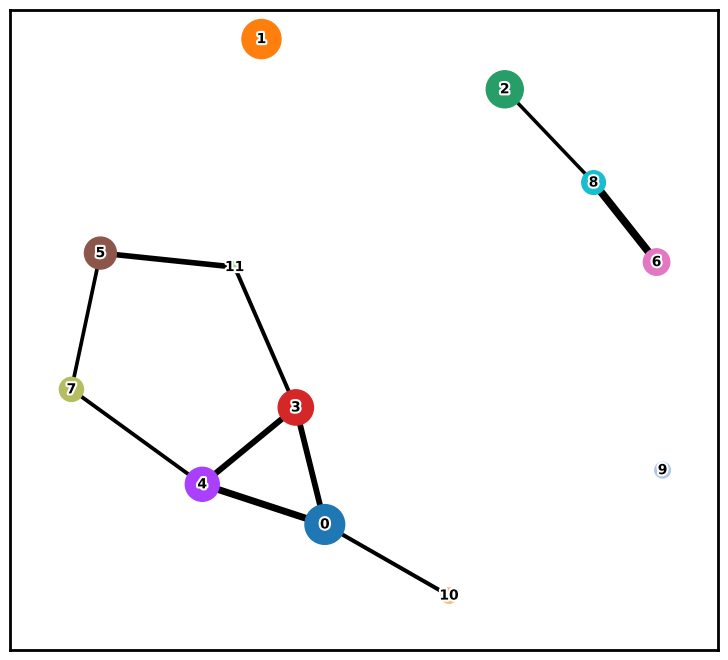

In [109]:
sc.tl.paga(adata_T_processed, groups='leiden')
sc.pl.paga(adata_T_processed,threshold = 0.3, labels=None, fontsize = 10, fontoutline = 3,node_size_scale = 3,node_size_power = 1,random_state = 0)

In [110]:
%matplotlib inline
sc.tl.umap(adata_T_processed, min_dist = 0.001, spread = 1.5,init_pos = 'paga')

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:04)


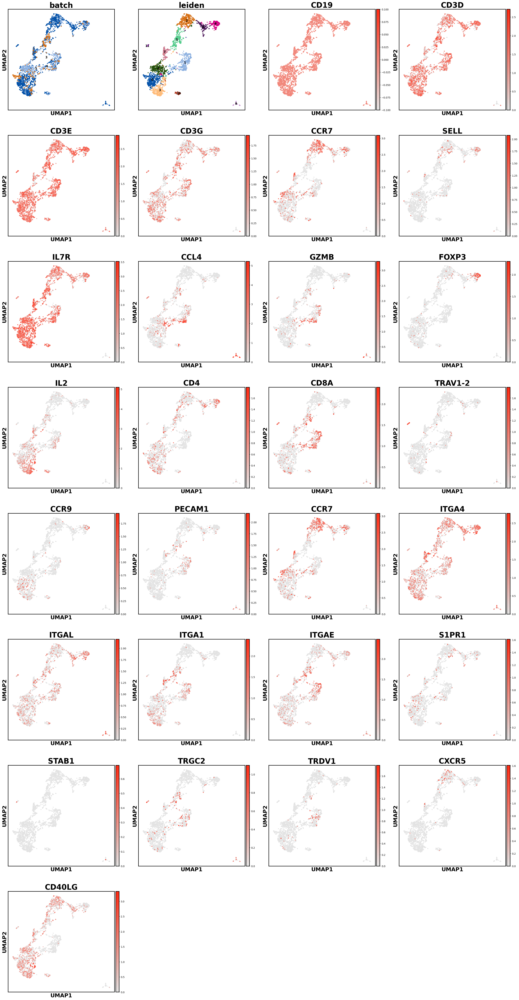

In [13]:
#plt.close()
%matplotlib inline
plt.rcParams['axes.linewidth'] = 2
fig = sc.pl.umap(adata_T_processed, color = ['batch','leiden','CD19','CD3D','CD3E','CD3G','CCR7','SELL','IL7R','CCL4','GZMB','FOXP3','IL2','CD4','CD8A','TRAV1-2','CCR9','PECAM1','CCR7','ITGA4','ITGAL',
                                            'ITGA1','ITGAE','S1PR1','STAB1','TRGC2','TRDV1','CXCR5','CD40LG'],
                                                size = 60, legend_loc = 'on data', palette  = my_palette, ncols = 4, cmap = my_cmap, return_fig = True, legend_fontsize = 'large')
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
#plt.savefig('overall_map_withunmatched.png')

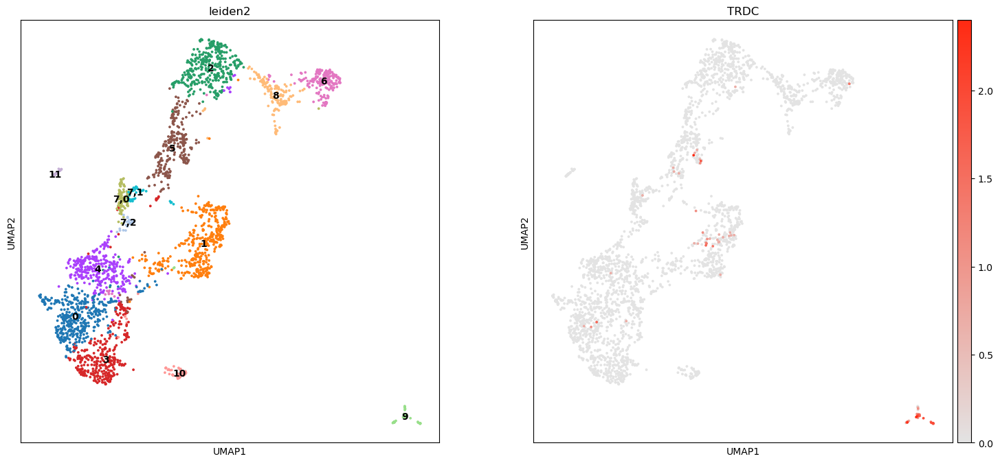

In [131]:
plt.rcParams['figure.figsize'] = [8,8]
sc.tl.leiden(adata_T_processed, restrict_to = ('leiden', ['7']), resolution = 0.5, key_added= 'leiden2')
sc.pl.umap(adata_T_processed, color=['leiden2','TRDC'], size = 30, legend_loc = 'on data', cmap = my_cmap)
#go back to the DE section to make sure this subcluster make sense

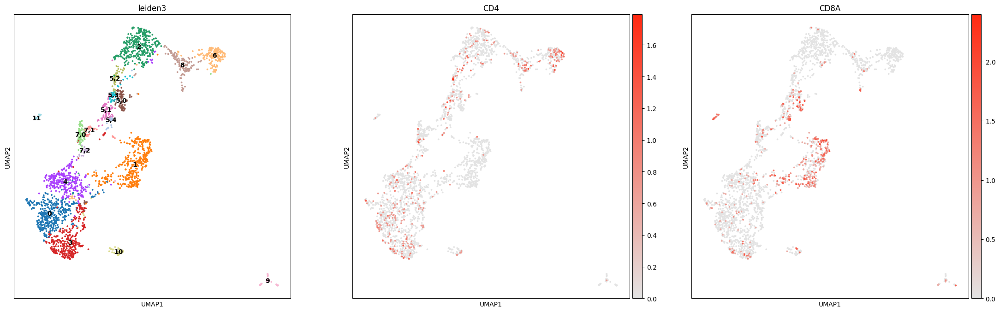

In [13]:
plt.rcParams['figure.figsize'] = [8,8]
sc.tl.leiden(adata_T_processed, restrict_to = ('leiden2', ['5']), resolution = 0.65, key_added= 'leiden3')
sc.pl.umap(adata_T_processed, color=['leiden3','CD4','CD8A'], size = 30, legend_loc = 'on data', cmap = my_cmap)
#go back to the DE section to make sure this subcluster make sense

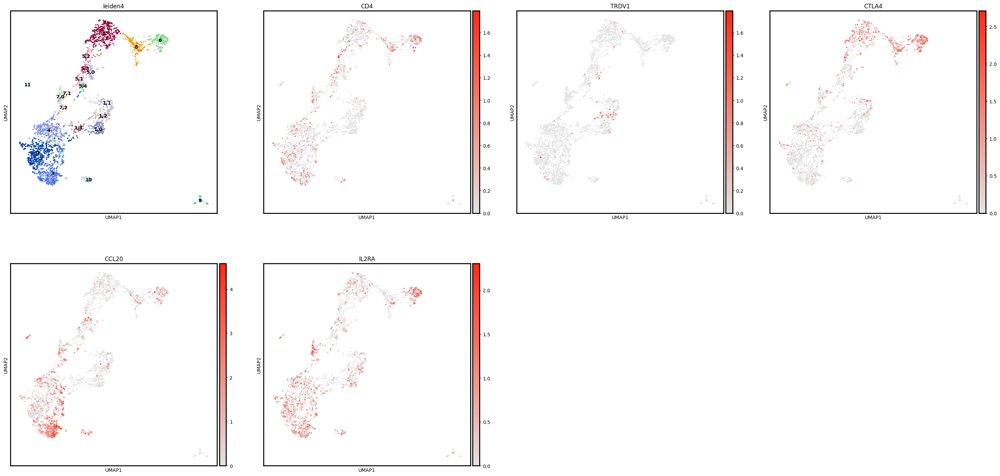

In [22]:
plt.rcParams['figure.figsize'] = [8,8]
sc.tl.leiden(adata_T_processed, restrict_to = ('leiden3', ['1']), resolution = 0.4, key_added= 'leiden4')
sc.pl.umap(adata_T_processed, color=['leiden4','CD4','TRDV1','CTLA4','CCL20','IL2RA'], size = 30, legend_loc = 'on data', cmap = my_cmap)
#go back to the DE section to make sure this subcluster make sense

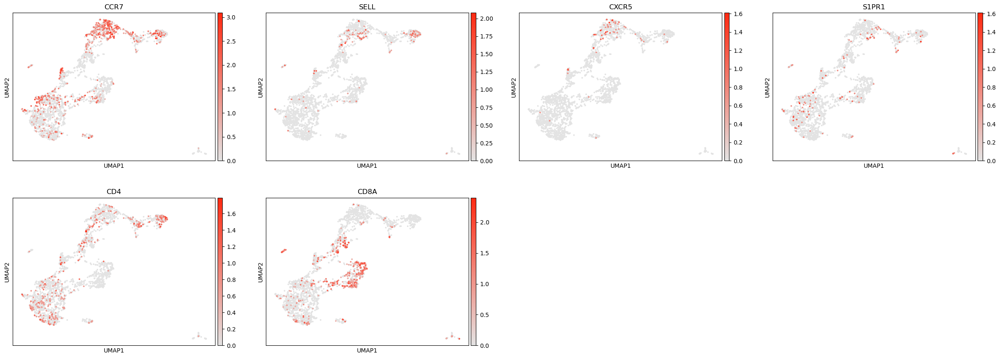

In [29]:
sc.pl.umap(adata_T_processed, color=['CCR7','SELL','CXCR5','S1PR1','CD4','CD8A'], size = 30, legend_loc = 'on data', cmap = my_cmap)
#go back to the DE section to make sure this subcluster make sense

In [21]:
del adata_T_processed.obs['leiden2']

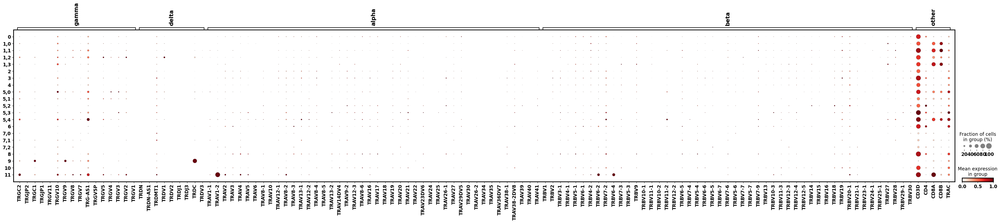

In [102]:
plt.rcParams.update({'font.size': 15, 'font.weight': 'heavy','axes.linewidth':2})
#plt.rcParams.update(plt.rcParamsDefault)
gamma_genesmask = [gene.startswith("TRG") for gene in adata.var_names]
gamma_genes = adata.var_names[gamma_genesmask]
delta_genesmask = [gene.startswith("TRD") for gene in adata.var_names]
delta_genes = adata.var_names[delta_genesmask]
alpha_genesmask = [gene.startswith("TRAV") for gene in adata.var_names]
alpha_genes = adata.var_names[alpha_genesmask]
beta_genesmask = [gene.startswith("TRBV") for gene in adata.var_names]
beta_genes = adata.var_names[beta_genesmask]
TCR_exp_set ={
"gamma": gamma_genes, "delta": delta_genes, "alpha": alpha_genes,"beta":beta_genes,"other": ['CD3D','CD4','CD8A','CD8B','TRAC']
}



sc.pl.dotplot(adata_T_processed,TCR_exp_set,groupby = 'leiden4' , vmax = 1, swap_axes = False, dot_min =0, dot_max =1,standard_scale = 'var')

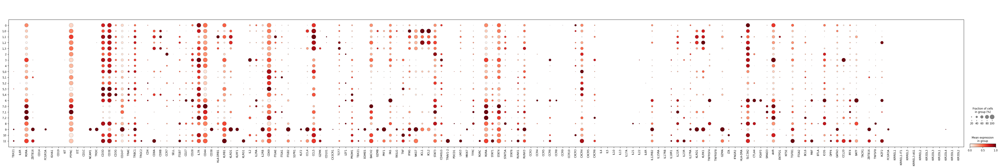

In [27]:
plt.rcParams.update({'font.size': 5, 'font.weight': 'heavy','axes.linewidth':5})
plt.rcParams.update(plt.rcParamsDefault)


sc.pl.dotplot(adata_T_processed,['TBX21','IL6R','RORA','ZBTB16','CD14','FCGR3A','IGHA1','CD19','KIT','PTPRC','LYZ','CD1C','NCAM1','TRDC','CD3D','CD3E','CD3G','CD247','TRAC','TRBC1','TRGC2','CD4','CD8A','CD8B','CCR7', 'SELL','ITGB7',
                                 'CD27', 'CD28', 'IL7R', 'CD44','CD38','HLA-DRB1', 'KLRB1','KLRD1','KLRF1','KLRG1', 'IL2',
       'IL2RA', 'IL2RB', 'CD69', 'ITGAE', 'ITGA1','ITGB2','S1PR1','KLF2','CCL4','CCL5', 'GZMK', 'CD101', 'CX3CR1',
       'TCF7', 'LEF1', 'PRDM1', 'TBX21', 'EOMES', 'BACH2', 'GZMB', 'PRF1',
       'FAS', 'FASLG', 'TNF', 'IFNG', 'NKG7', 'XCL1',
       'XCL2', 'STAT3', 'CD40LG', 'TRAV1-2', 'PDCD1','LAG3',
       'MKI67', 'TFRC', 'RORC', 'RORA', 'STAT1', 'STAT4', 'STAT5A',
       'STAT6', 'RUNX1', 'RUNX3', 'CCR3', 'CCR4', 'CCR5', 'CCR6', 'CCR8','CCR9',
       'CCR10','CXCR3',  'CXCR4', 'CXCR5', 'CXCR6', 'IL4', 'IL5', 'IL10', 'IL13', 'IL17A',
       'IL21', 'IL22', 'IL6R', 'IL12RB2', 'IL15RA', 'IL17RB', 'IL18R1',
       'IL21R', 'IL23R', 'IL27RA', 'KLRD1', 'KLRK1','TNFRSF4', 'TNFRSF8', 'GZMA',
       'LTA', 'IFNGR2', 'HLA-DRA', 'SLC3A2', 'CTLA4', 'FOXP3', 'SMAD3',
       'AHR', 'ENTPD1', 'NT5E', 'TGFB1', 'ITGA2', 'BCL6', 'MAF', 'BTLA',
       'ICOS', 'DPP4', 'GATA3', 'CCL20', 'IRF4', 'BATF', 'TACR1',
       'ZBTB16', 'TNFSF8', 'IKZF2','FCGR3A','KIRREL1', 'KIRREL1-IT1', 'KIRREL3', 'KIRREL3-AS1', 'KIRREL2',
       'KIR3DL3', 'KIR2DL3', 'KIR2DL1', 'KIR2DL4', 'KIR3DL1', 'KIR3DL2'],groupby = 'leiden4' , vmax = 1, 
              swap_axes = False ,dot_min = 0.1,standard_scale = 'var')
# Checked IL9, nothing

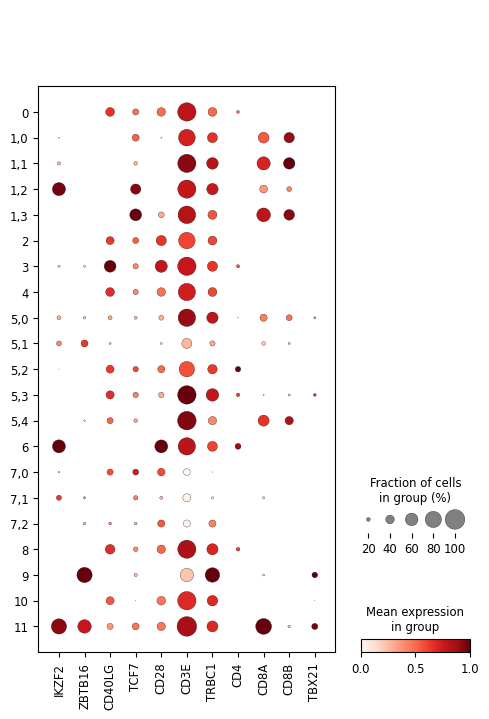

In [52]:
plt.rcParams.update({'font.size': 5, 'font.weight': 'heavy','axes.linewidth':5})
plt.rcParams.update(plt.rcParamsDefault)


sc.pl.dotplot(adata_T_processed,['IKZF2','ZBTB16','CD40LG','TCF7','CD28','CD3E','TRBC1','CD4','CD8A','CD8B','TBX21'],groupby = 'leiden4' , vmax = 1, 
              swap_axes = False ,dot_min = 0.1,standard_scale = 'var')
# Checked IL9, nothing

In [64]:
sc.tl.rank_genes_groups(adata_T_processed, groupby='leiden4', key_added='rank',method = 'wilcoxon')

In [67]:
[pass_genes_up, pass_genes_down] = DE_to_df(adata_T_processed, rank_key='rank', _padj_thresh = 0.05, _logfc_thresh = 2)

In [33]:
adata_T_processed.obs['celltype_highres'] = adata_T_processed.obs['leiden4']
adata_T_processed.obs = adata_T_processed.obs.replace({'celltype_highres' : { '0': 'TCRab CD4 Mobile TRM',
                                                  '1,0':'TCRab CD8 Mobile TRM',
                                                  '1,1':'TCRab CD8 TRM',
                                                  '1,2':'TCRgd TRM',
                                                  '1,3':'TCRab CD8 Mobile TRM',
                                                                            '2':'TCRab CD4 Mobile TRM',
                                                                            '3':'TCRab CD4 Mobile TRM',
                                                                            '4':'TCRab CD4 Mobile TRM',  
                                                  '5,0':'TCRab CD8ab TRM',
                                                  '5,1':'TCRab CD4 Mobile TRM',
                                                  '5,2':'TCRab CD4 TRM',                           
                                                  '5,3':'TCRab CD4 TRM',                           
                                                  '5,4':'TCRab CD8ab TRM',
                                                                            '6':'TCRab CD4 FOXP3+ Treg',
                                                                            '7,0':'ILC1',
                                                                            '7,1':'ILC1',
                                                                            '7,2':'ILC1',
                                                                            '8':'TCRab CD4 TRM',
                                                                            '9':'NK',
                                                                            '10':'TCRab DN Mobile TRM',
                                                                            '11': 'TCRab CD8aa MAIT'
                                                                           }})

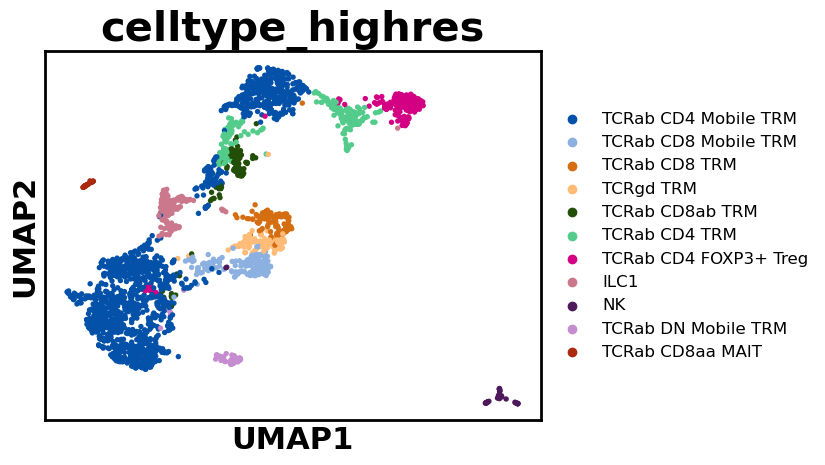

In [35]:
#plt.close()
%matplotlib inline
adata_T_processed = adata_T_processed[adata_T_processed.obs['celltype_lowres']!='T Cells',:]
plt.rcParams['axes.linewidth'] = 2
fig = sc.pl.umap(adata_T_processed, color = ['celltype_highres'],
                 size = 60, palette  = my_palette, ncols = 4, cmap = my_cmap, return_fig = True, legend_fontsize = 'large')
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
#plt.savefig('overall_map_withunmatched.png')

In [37]:
adata_T_processed.write_h5ad('T_annotated.h5ad')

In [88]:
adata_T_processed = sc.read_h5ad('T_annotated.h5ad')

### High Resolution annotation

In [145]:
adata.obs['celltype_highres'] = adata.obs['celltype_lowres'].astype(str)
for i in adata_IEC_processed.obs_names:
    adata.obs.loc[i,'celltype_highres'] = adata_IEC_processed.obs.loc[i,'celltype_highres']
for i in adata_B_processed.obs_names:
    adata.obs.loc[i,'celltype_highres'] = adata_B_processed.obs.loc[i,'celltype_highres']
for i in adata_mono_processed.obs_names:
    adata.obs.loc[i,'celltype_highres'] = adata_mono_processed.obs.loc[i,'celltype_highres']
for i in adata_T_processed.obs_names:
    adata.obs.loc[i,'celltype_highres'] = adata_T_processed.obs.loc[i,'celltype_highres']

In [ ]:
#plt.close()
%matplotlib inline
plt.rcParams['axes.linewidth'] = 2
fig = sc.pl.umap(adata, color = ['celltype_highres'],
                 size = 30, palette  = my_palette, ncols = 4, cmap = my_cmap, return_fig = True, legend_fontsize = 'large')
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
#plt.savefig('overall_map_withunmatched.png')

In [151]:
adata.write_h5ad('gut_annotated.h5ad')

In [ ]:
sc.pl.dotplot(adata, var_names=['CD3D','CD3E','CD3G','CD274','TRDC'],groupby= 'celltype_highres')

In [7]:
adata.obs.groupby('celltype_highres')['celltype_lowres'].apply(set)

celltype_highres
CD16- Conventional Monocytes                         {Monocytes}
Colonocytes                        {Intestinal Epithelial Cells}
Enteroendocrine Cells              {Intestinal Epithelial Cells}
Fibroblast                                          {Fibroblast}
Fibroblastic Reticular Cells      {Fibroblastic Reticular Cells}
Goblet Cells                       {Intestinal Epithelial Cells}
ILC1                                                       {ILC}
ILC3                                                       {ILC}
Intestinal Stem Cells              {Intestinal Epithelial Cells}
Lymphatic Endothelial Cells                  {Endothelial Cells}
M2-like CD16+ Macrophages                          {Macrophages}
MAdCAM1+ Endothelial Cells                   {Endothelial Cells}
MAdCAM1- Endothelial Cells                   {Endothelial Cells}
Memory B Cells                                         {B Cells}
Telocytes                                            {Telocytes}
Muscular

In [21]:
adata.obs['celltype_lowres'] = adata.obs['celltype_lowres'].astype(str)
adata.obs['celltype_lowres'][adata.obs['celltype_highres'] == 'ILC1'] = 'ILC'
adata.obs['celltype_lowres'][adata.obs['celltype_highres'] == 'ILC3'] = 'ILC'
adata.obs['celltype_lowres'][adata.obs['celltype_highres'] == 'TCRab CD4 Mobile TRM'] = 'T Cells'
adata.obs['celltype_lowres'][adata.obs['celltype_highres'] == 'MAdCAM1+ Endothelial Cells'] = 'Endothelial Cells'
adata.obs['celltype_lowres'][adata.obs['celltype_highres'] == 'MAdCAM1- Endothelial Cells'] = 'Endothelial Cells'
adata.obs['celltype_lowres'][adata.obs['celltype_highres'] == 'Tuft Cells'] = 'Intestinal Epithelial Cells'
adata.obs['celltype_lowres'][adata.obs['celltype_highres'] == 'Muscularis Smooth Muscle Cells'] = 'Smooth Muscle Cells'
adata.obs['celltype_lowres'][adata.obs['celltype_highres'] == 'Vascular Smooth Muscle Cells'] = 'Smooth Muscle Cells'
adata.obs['celltype_lowres'][adata.obs['celltype_highres'] == 'Lymphatic Endothelial Cells'] = 'Endothelial Cells'
adata.obs['celltype_lowres'][adata.obs['celltype_highres'] == 'CD16- Conventional Monocytes'] = 'Monocytes'
adata.obs['celltype_lowres'][adata.obs['celltype_highres'] == 'M2-like CD16+ Macrophages'] = 'Macrophages'
adata.obs['celltype_lowres'][adata.obs['celltype_highres'] == 'cDC2'] = 'Dendritic Cells'

In [23]:
os.chdir(r'E:\AAA_Labwork\Tcell tissues\v2')
adata.write_h5ad('gut_annotated.h5ad')